In [1]:
import os
import numpy as np
import pandas as pd
import seaborn as sns

In [2]:
plt.rcParams['figure.dpi'] = 180
sns.set_context('talk', font_scale= 1.2)

# Figure 3A

In [3]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20200508_maternal500_fetal_wo_outliers.csv')
adata_df = pd.read_csv(umap_path)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3049: DtypeWarning: Columns (42) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [4]:
clean_df = adata_df[(adata_df['test_status'] == 'test') & 
                    adata_df['organ'].isin(['PB', 'PL_F', 'PL_M'])]
bl_df = clean_df[(clean_df['challenge'] == 'sal') & (clean_df['timePI'] == '2hr') & (clean_df['origin'] == 'maternal')]

In [5]:
bl_df.columns

Index(['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD194', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86',
       'prpS6', 'day', 'organ', 'id', 'cage', 'timePI', 'challenge', 'origin',
       'location', 'leiden1', 'PD-L1_status', 'PD-1_status', 'CTLA-4_status',
       'CD64_status', 'CD62L_status', 'CD25_status', 'CD194_status',
       'CD69_status', 'CD80_status', 'CD86_status', 'B220_status',
       'CD40_status', 'CD44_status', 'IdU_status', 'cell_descript',
       'test_status', 'sample', 'cell_type', 'compartment', 'umap1', 'umap2',
       'cell_type_v2', 'compartment2'],
      dtype='object')

In [6]:
leiden_color_dictv2 = {'B cells': '#355C7D',
 'CD4+ T cells': '#F8B195',
 'CD8+ T cells': '#F67280',
 'Eosinophils': '#A30059',
 'Basophils': '#b4b4ee',
 'Monocytes': '#6C5B7B',
 'NK cells': '#b4d1ee',
 'Neutrophils': '#999097'}

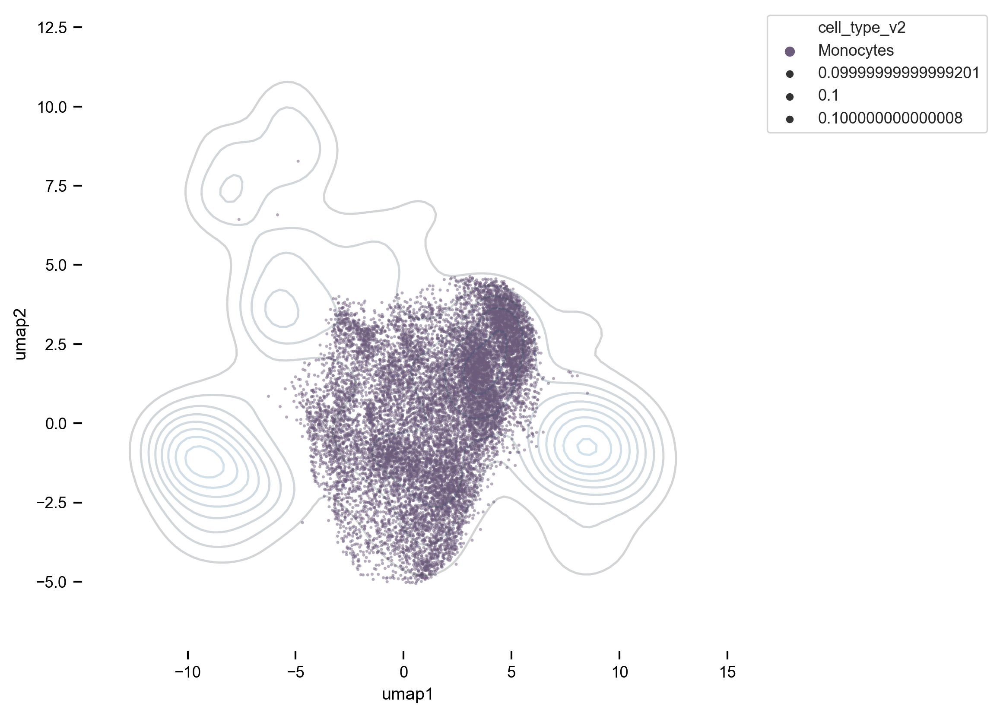

In [7]:
sns.set_context('paper', font_scale= 1)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = bl_df['umap1'], data2= bl_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)

sns.scatterplot(data = bl_df[bl_df['cell_type_v2']=='Monocytes'], 
                hue = 'cell_type_v2', palette = leiden_color_dictv2, x='umap1', y='umap2', marker='.', size = 0.1, 
                linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Supplementary Figure 3A

In [3]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
adata_path = os.path.join(subsample_path, 'maternal500_fetal_wo_outliers.h5ad')
adata = sc.read_h5ad(adata_path)

In [6]:
run2019 = ['1136_1_E14.5_sal_2hr_PB-EV',
            '1136_1_E14.5_sal_2hr_PL-T', 
            '1136_1_E14.5_sal_2hr_PL-EV',
            '2849_11_E12.5_sal_2hr_PB-EV',
            '8241_17_E18.5_sal_2hr_PB-EV',
            '8241_17_E18.5_sal_2hr_PL-T',
            '8241_17_E18.5_sal_2hr_PL-EV',
            '8241_18_E18.5_sal_2hr_PB-EV',
            '8241_18_E18.5_sal_2hr_PL-T', 
            '8241_18_E18.5_sal_2hr_PL-EV',
            '8240_11_E14.5_sal_2hr_PB-EV',
            '8240_11_E14.5_sal_2hr_PL-T', 
            '8240_11_E14.5_sal_2hr_PL-EV',
            '8238_4_E12.5_sal_2hr_PB-EV', 
            '8238_4-3_E12.5_sal_2hr_PL-T',
            '8238_4-3_E12.5_sal_2hr_PL-EV',
            '8238_4-4_E12.5_sal_2hr_PL-T',
            '8238_4-4_E12.5_sal_2hr_PL-EV', 
            '8238_4-5_E12.5_sal_2hr_PL-T',
            '8238_4-5_E12.5_sal_2hr_PL-EV', 
            '8238_4-6_E12.5_sal_2hr_PL-T',
            '8238_4-6_E12.5_sal_2hr_PL-EV', 
            '8238_4-7_E12.5_sal_2hr_PL-T',
            '8238_4-7_E12.5_sal_2hr_PL-EV',
            '8238_1_E12.5_sal_2hr_PB-EV',
            '8238_1_E12.5_sal_2hr_PL-T', 
            '8238_1_E12.5_sal_2hr_PL-EV',
            '6943_15_E10.5_sal_2hr_PB-EV',
            '6944_17_E10.5_sal_2hr_PB-EV',
          '3574_2_E12.5_lps_24hr_PB-EV', '3574_2_E12.5_lps_24hr_PL-T',
       '1139_18_E14.5_lps_2hr_PL-EV', '1139_18_E14.5_lps_2hr_PL-T',
       '1139_20_E14.5_lps_2hr_PL-T', '1139_20_E14.5_lps_2hr_PL-EV',
       '8240_20_E12.5_lps_2hr_PL-T', '8240_20_E12.5_lps_2hr_PL-EV',
       '8238_5_E12.5_lps_2hr_PL-T', '8238_5_E12.5_lps_2hr_PL-EV',
       '9582_12_E12.5_lps_2hr_PB-EV', '9582_12_E12.5_lps_2hr_PL-T',
       '9582_12_E12.5_lps_2hr_PL-EV', '1139_18_E14.5_lps_2hr_PB-EV',
       '1139_20_E14.5_lps_2hr_PB-EV', '1137_10_E14.5_lps_24hr_PB-EV',
       '1137_10_E14.5_lps_24hr_PL-T', '1137_10_E14.5_lps_24hr_PL-EV',
       '2990_9_E14.5_lps_24hr_PB-EV', '2990_9_E14.5_lps_24hr_PL-T',
       '2991_3_E14.5_lps_24hr_PL-T', '8240_13_E14.5_lps_2hr_PB-EV',
       '8240_13_E14.5_lps_2hr_PL-T', '8240_13_E14.5_lps_2hr_PL-EV',
       '0438_3_E14.5_lps_24hr_PB-EV', '0438_3_E14.5_lps_24hr_PL-T',
       '8240_20_E12.5_lps_2hr_PB-EV', '8238_5_E12.5_lps_2hr_PB-EV']

run2016 = ['0749_6_E12.5_lps_24hr_PB-EV', '0749_7_E12.5_lps_24hr_PB-EV']

In [9]:
adata.obs['batch_run'] = '2018'
mask2019 = adata.obs['challenge'].isin(['polyic']) | adata.obs['sample'].isin(run2019)
adata.obs['batch_run'][mask2019] = '2019'
mask2016 = adata.obs['sample'].isin(run2016)
adata.obs['batch_run'][mask2016] = '2016'

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.


In [11]:
adata.obs['batch_run'].unique()

array(['2018', '2019', '2016'], dtype=object)

In [12]:
mo_adata = adata[adata.obs['cell_type_v2'].isin(['Monocytes'])&
                 adata.obs['organ'].isin(['PB', 'PL_F', 'PL_M', 'PL_U', 'decidua']) &
                 (adata.obs['origin'] == 'maternal') &
                 (adata.obs['challenge'] == 'sal') &
                 (adata.obs['timePI'] == '2hr') &
                 (adata.obs['batch_run'] == '2018')]

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/anndata/core/anndata.py:299: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


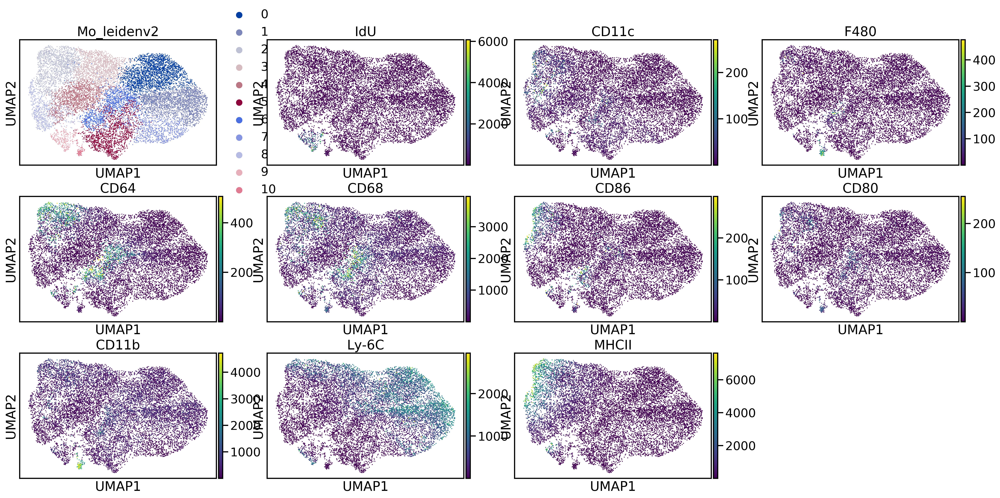

In [18]:
clustering = ['IdU','CD11c','F480','CD64',
       'CD68', 'CD86', 'CD80',#'CD11b', 
       'Ly-6C','MHCII']
mo_adata.obsm['cluster_channels'] = mo_adata[:, clustering].X
sc.pp.neighbors(mo_adata, n_neighbors = 20, use_rep= 'cluster_channels', random_state = 1)
sc.tl.umap(mo_adata, random_state = 1)
sc.tl.leiden(mo_adata, resolution=0.5, key_added = 'Mo_leidenv2', random_state = 1)
sc.pl.umap(mo_adata, color = ['Mo_leidenv2', 'IdU','CD11c','F480','CD64', 'CD68', 'CD86', 'CD80','CD11b','Ly-6C','MHCII'])

In [19]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
mo_adata_path = os.path.join(subsample_path, '20201211_MO_2018SALmaternal500wo_outliers.h5ad')
mo_adata.write(mo_adata_path)

In [20]:
umap_pd = pd.DataFrame(data = mo_adata.obsm['X_umap'], columns = ['umap1', 'umap2']).set_index(mo_adata.obs_names)
adata_df = pd.DataFrame(data = mo_adata.X, columns = mo_adata.var_names).set_index(mo_adata.obs_names)
adata_df = pd.concat([adata_df, mo_adata.obs, umap_pd], axis = 1, join = 'outer', copy = False)

adata_df.rename(columns = {'Mo_leidenv2': 'Mo_leiden2'}, inplace = True)

subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20201211_2018SALMo_maternal500wo_outliers.csv')
adata_df.to_csv(umap_path, index = False)

In [24]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20201211_2018SALMo_maternal500wo_outliers.csv')
mono_df= pd.read_csv(umap_path)
mono_df.loc[:, ['cage', 'id', 'batch_run', 'Mo_leiden2']] = mono_df.loc[:, ['cage', 'id', 'batch_run', 'Mo_leiden2']].astype(str)

In [83]:
mono_df.head(5)

,CD45-retroorbital,CD45.2,CD45.1,IdU,B220,Ly-6G,CD11c,TCRb,CD115,CD69,...,leiden0,gen_cell_type,cell_type_v2,compartment2,batch_run,Mo_leiden2,umap1,umap2,mo_type,canonical_cat
0,4.440127,3.113236,0.000000,0.917495,1.681932,1.248900,0.003837,0.565267,0.216015,0.009731,...,3,DCs,Monocytes,PL-EV,2018,3,-1.842028,3.591639,Presenting_Ly6Cmid,classical
1,3.592813,2.023786,0.102777,0.323869,1.415480,0.299612,0.084553,0.009124,0.017124,0.009731,...,13,Mo,Monocytes,PL-EV,2018,4,-3.857234,0.348802,Presenting_Ly6Clow,intermediate
2,1.471493,3.678320,0.000000,5.177753,1.015315,0.350451,2.000770,0.386624,0.791681,0.429151,...,7,DCs,Monocytes,PL-T,2018,9,-4.122046,-3.444259,Proliferating,non_classical
3,4.987449,3.573796,0.000000,0.001446,1.126140,0.601137,0.316771,0.057334,0.316629,0.009731,...,0,Mo,Monocytes,PL-EV,2018,0,3.146329,2.738417,Ly6Chi,classical
4,1.782389,3.171191,0.287883,0.225362,0.278570,0.016804,2.255548,0.009124,0.017124,0.009731,...,3,DCs,Monocytes,PL-T,2018,2,-4.529738,3.316543,Presenting_CD11c+PDL1+,intermediate


In [90]:
samples_whole_PL = ['748_5_E12.5_sal_24hr_PL-T',
                    '438_4_E14.5_sal_24hr_PL-T',
                    '439_6_E14.5_sal_24hr_PL-T',
                    '2991_5_E14.5_sal_24hr_PL-T',
                    '3574_2_E12.5_lps_24hr_PL-T',
                    '3574_1_E12.5_sal_24hr_PL-T',
                    '3574_1_E12.5_sal_24hr_PL-EV',
                    '3576_15_E12.5_sal_24hr_PL-T',
                    '3576_15_E12.5_sal_24hr_PL-EV']
PL_mask = (mono_df['sample'].isin(samples_whole_PL))
mono_df['compartment2'][PL_mask] = 'PL-whole'

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # This is added back by InteractiveShellApp.init_path()


In [91]:
mono_df['compartment2'].unique()

array(['PL-EV', 'PL-T', 'PB-EV', nan], dtype=object)

In [85]:
mono_df.to_csv(umap_path, index = False)

In [28]:
mono_clean_df = mono_df[(mono_df['test_status'] == 'test') & mono_df['compartment2'].isin(['PB-EV', 'PL-EV', 'PL-T'])]

In [29]:
mono_clean_df['Mo_leiden2'].unique()

array(['3', '4', '9', '0', '2', '6', '1', '7', '8', '5', '10'],
      dtype=object)

In [31]:
Mo_leiden2_dict = {'0':'#66a61e',
'1': '#d6bcc0',
'2': '#876507',
'3': '#d67c0d',
'4': '#023fa5',
'5': '#e7298a',
'6': '#d60d0d',
'7': '#7570b3',
'8': '#772d91',
'9': '#d6d60d',
'10': '#7d7170'}

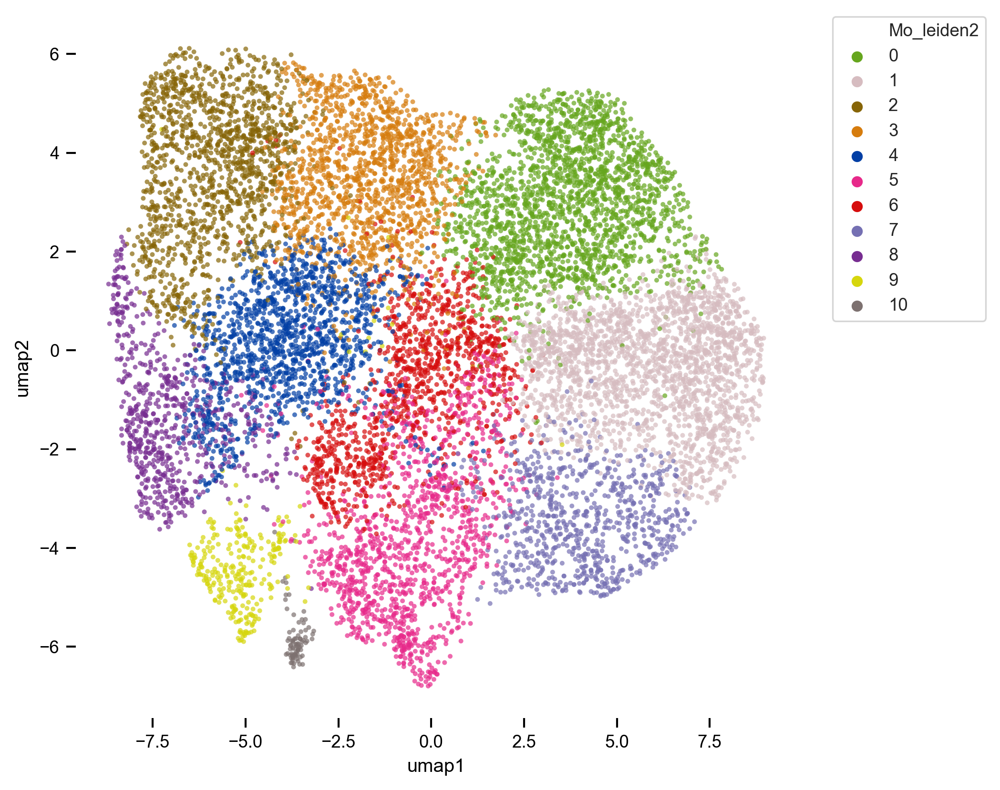

In [32]:
sns.set_context('paper', font_scale= 1)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.scatterplot(x='umap1', y='umap2', 
                data = mono_clean_df, 
                hue = 'Mo_leiden2', hue_order = ['0', '1', '2', '3', '4', '5','6', '7', '8', '9', '10'],
                palette = Mo_leiden2_dict, 
                marker='.', linewidth = 0, alpha = 0.7)
sns.set_style("whitegrid", {'axes.grid' : False})
sns.despine(f, left=True, bottom=True)
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Supplementary figure 3b

In [82]:
clustering = ['IdU',
 'CD11c',
 'F480',
 'CD64',
 'CD68',
 'CD86',
 'CD80',
 #'CD11b',
 'Ly-6C',
 'MHCII', 
 'PD-L1']

In [83]:
mono_clean_df.columns

Index(['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD194', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86',
       'prpS6', 'day', 'organ', 'id', 'cage', 'timePI', 'challenge', 'origin',
       'location', 'leiden1', 'PD-L1_status', 'PD-1_status', 'CTLA-4_status',
       'CD64_status', 'CD62L_status', 'CD25_status', 'CD194_status',
       'CD69_status', 'CD80_status', 'CD86_status', 'B220_status',
       'CD40_status', 'CD44_status', 'IdU_status', 'cell_descript',
       'test_status', 'sample', 'cell_type', 'compartment', 'leiden0',
       'gen_cell_type', 'cell_type_v2', 'compartment2', 'batch_run',
       'Mo_leiden2', 'umap1', 'umap2'],
      dtype='object')

In [84]:
mono_clean_df[clustering] = mono_clean_df[clustering].apply(lambda x:(x-x.min()) / (x.max()-x.min()))
mono_melt= mono_clean_df.melt(id_vars=['compartment2','Mo_leiden2', 'cage','id', 'day', 'umap1', 'umap2'], value_vars = clustering)
mono_melt.rename(columns = {'variable': 'marker', 'value': 'median'}, inplace = True)

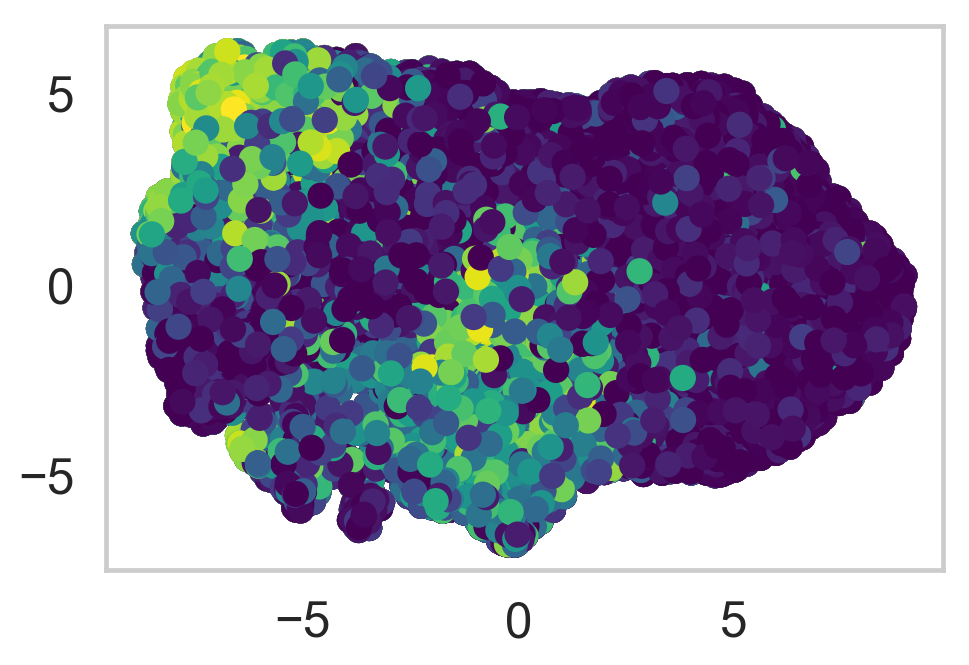

In [85]:
points = plt.scatter(mono_melt['umap1'], mono_melt['umap2'], c = mono_melt['median'], cmap='viridis')

In [86]:
mono_melt.head(5)

,compartment2,Mo_leiden2,cage,id,day,umap1,umap2,marker,median
0,PL-EV,3,9582,14,E15.5,-1.842028,3.591639,IdU,0.117672
1,PL-EV,4,9582,14,E15.5,-3.857234,0.348802,IdU,0.041523
2,PL-T,9,9582,14,E15.5,-4.122046,-3.444259,IdU,0.664162
3,PL-EV,0,9582,14,E15.5,3.146329,2.738417,IdU,0.000164
4,PL-T,2,9582,14,E15.5,-4.529738,3.316543,IdU,0.028887


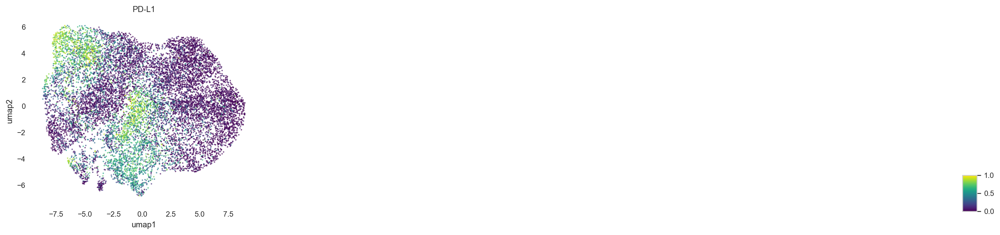

In [88]:
sns.set_context('paper', font_scale= 1)
g = sns.relplot(x='umap1', y= 'umap2', hue = 'median', col= 'marker', data= mono_melt[mono_melt['marker'] == 'PD-L1'],
                height=4, aspect=1, kind="scatter", palette = 'viridis', col_wrap=4,
                marker='.', size = 0.1, linewidth = 0, alpha = 0.7, legend = False).set_titles('{col_name}')
cax = g.fig.add_axes([1, .11, 0.015, 0.15])
plt.colorbar(points, cax=cax)
sns.despine(g, left=True, bottom=True)

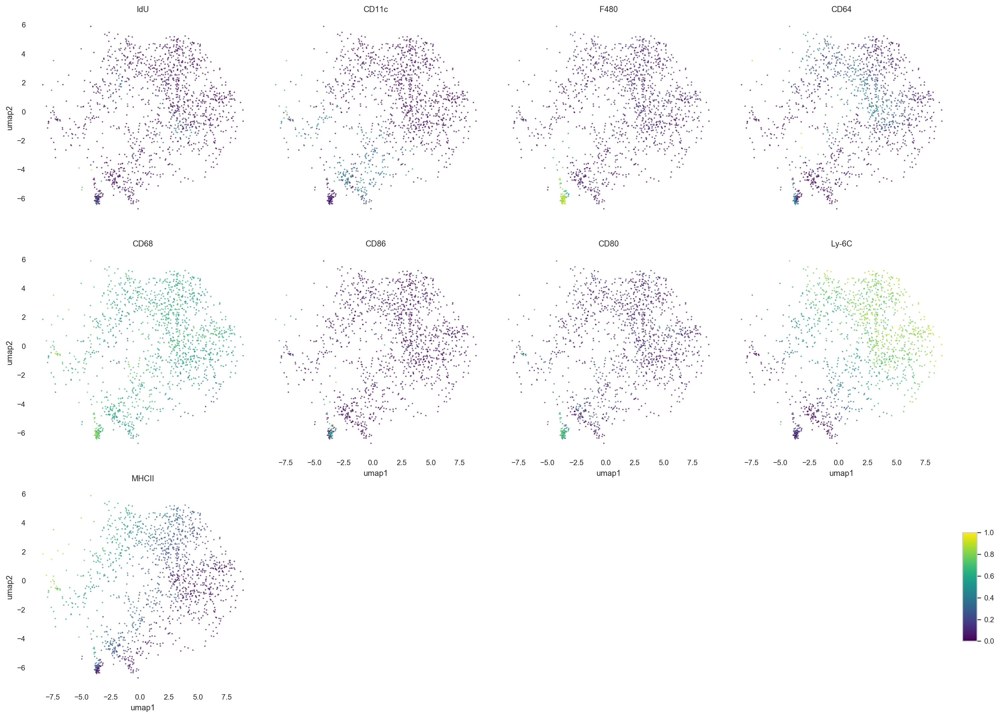

In [66]:
sns.set_context('paper', font_scale= 1)
g = sns.relplot(x='umap1', y= 'umap2', hue = 'median', col= 'marker', data= mono_melt[mono_melt['compartment2'] == 'PB-EV'],
                height=4, aspect=1, kind="scatter", palette = 'viridis', col_wrap=4,
                marker='.', size = 0.1, linewidth = 0, alpha = 0.7, legend = False).set_titles('{col_name}')
cax = g.fig.add_axes([1, .11, 0.015, 0.15])
plt.colorbar(points, cax=cax)
sns.despine(g, left=True, bottom=True)

# Figure 3B

In [86]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20201211_2018SALMo_maternal500wo_outliers.csv')
mono_df= pd.read_csv(umap_path)
mono_df.loc[:, ['cage', 'id', 'batch_run', 'Mo_leiden2']] = mono_df.loc[:, ['cage', 'id', 'batch_run', 'Mo_leiden2']].astype(str)

In [88]:
mono_df['compartment2'].unique()

array(['PL-EV', 'PL-T', 'PB-EV', nan], dtype=object)

In [91]:
columns_int = ['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86', 'batch_run', 'timePI','cage','challenge', 'day', 'id', 'Mo_leiden2', 'compartment2']
mo_clean_df = mono_df[(mono_df['batch_run']=='2018') & 
                      (mono_df['test_status'] == 'test') &  
                      mono_df['compartment2'].isin(['PB-EV', 'PL-EV', 'PL-T'])]
pivot_series = mo_clean_df[columns_int].pivot_table(columns= ['Mo_leiden2','compartment2','challenge', 'cage','id', 'day'], aggfunc = 'median')

median_df = pd.DataFrame(pivot_series)
median_df.reset_index(inplace = True)
median_df.rename(columns = {'level_0': 'marker', 0: 'median'}, inplace = True)
mean_medians = median_df.groupby(['marker','Mo_leiden2']).mean()
mean_medians.reset_index(inplace = True)
heatmap_df = mean_medians.pivot_table(index = 'Mo_leiden2', columns = 'marker', values = 'median')

In [92]:
heatmap_ready = heatmap_df.apply(lambda x:(x-x.min()) / (x.max()-x.min()), axis = 0)

In [93]:
markers_int = ['Ly-6C',
               #'CD11b',
               'CD11c',
               'CD64',
               'CD68',
               'CD80',
               'CD86',
               'IdU',
               'F480',
               'MHCII',
               'PD-L1']

Mo_leiden2_dict = {'F480CD11b': '#d6d60d',
                  'presentingPDL1': '#66a61e',
                  'IdU': '#772d91',
                  'PhagocyticPDL1': '#7570b3',
                  'CD11cMHCII':'#d60d0d',
                  'MHCIICD11b': '#d6bcc0',
                  'Ly6CCD64CD68MHCII': '#876507',
                  'hiLy6C':'#d67c0d',
                  'PatrollingPDL1':'#e7298a',
                  'Ly6CCD11bCD64':'#023fa5'}

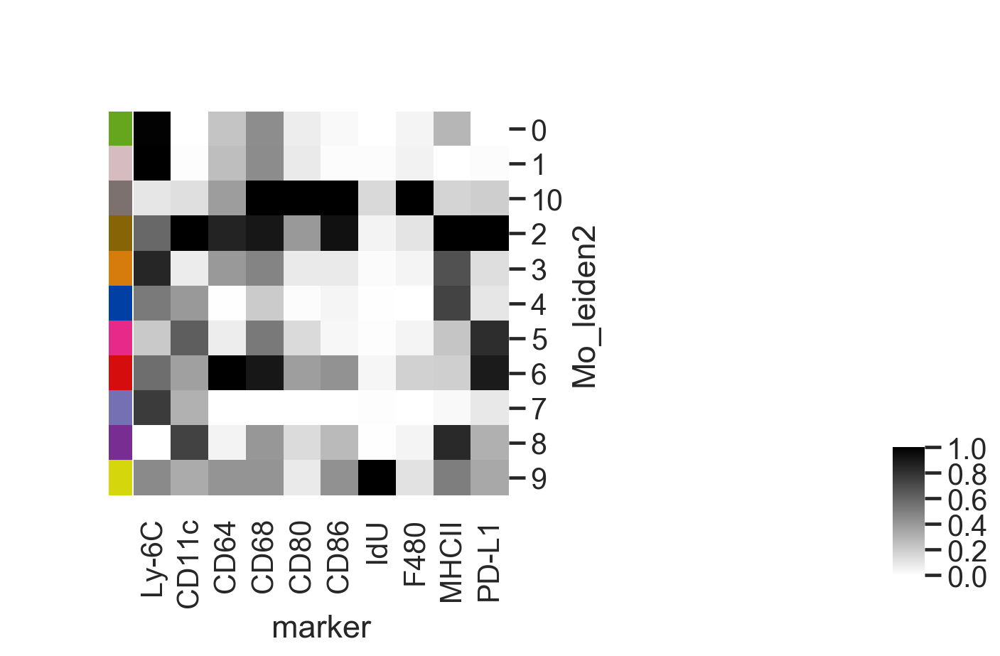

In [94]:
sns.set_context('talk', font_scale= 1)
row_colors = heatmap_ready.index.map(Mo_leiden2_dict)
cg = sns.clustermap(heatmap_ready.loc[:, markers_int], figsize=(5,5),
               cmap = 'binary', row_colors = row_colors,
               row_cluster = False, col_cluster = False)
plt.setp(cg.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
cg.cax.set_position((1.5,0.0,.05,.2))

# Assign MP phenotypes to clusters

In [4]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20201211_2018SALMo_maternal500wo_outliers.csv')
mono_df= pd.read_csv(umap_path)
mono_df.loc[:, ['cage', 'id', 'batch_run', 'Mo_leiden2']] = mono_df.loc[:, ['cage', 'id', 'batch_run', 'Mo_leiden2']].astype(str)

In [7]:
markers_int = ['Ly-6C',
               #'CD11b',
               'CD11c',
               'CD64',
               'CD68',
               'CD80',
               'CD86',
               'IdU',
               'F480',
               'MHCII',
               'PD-L1']

In [8]:
Mo_leiden2_dict = {'0':'#66a61e',
'1': '#d6bcc0',
'2': '#876507',
'3': '#d67c0d',
'4': '#023fa5',
'5': '#e7298a',
'6': '#d60d0d',
'7': '#7570b3',
'8': '#772d91',
'9': '#d6d60d',
'10': '#7d7170'}

In [6]:
columns_int = ['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86', 'batch_run', 'timePI','cage','challenge', 'day', 'id', 'Mo_leiden2', 'compartment2']
mo_clean_df = mono_df[(mono_df['batch_run']=='2018') & 
                      (mono_df['test_status'] == 'test') &  
                      mono_df['compartment2'].isin(['PB-EV', 'PL-EV', 'PL-T'])]
pivot_series = mo_clean_df[columns_int].pivot_table(columns= ['Mo_leiden2','compartment2','challenge', 'cage','id', 'day'], aggfunc = 'median')

median_df = pd.DataFrame(pivot_series)
median_df.reset_index(inplace = True)
median_df.rename(columns = {'level_0': 'marker', 0: 'median'}, inplace = True)

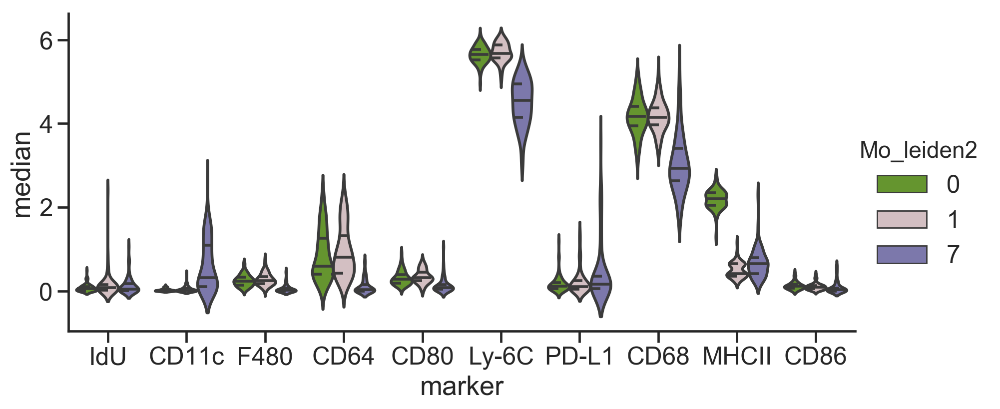

In [12]:
sns.set_style("ticks")
sns.catplot(x = 'marker', y = 'median', kind = 'violin',inner = 'quart',
            hue = 'Mo_leiden2', palette = Mo_leiden2_dict,
            scale='count', ci = 68, 
            data = median_df[median_df['marker'].isin(markers_int) & 
                             median_df['Mo_leiden2'].isin(['0', '1', '7'])],
            legend_out = True, aspect = 2, height = 5)

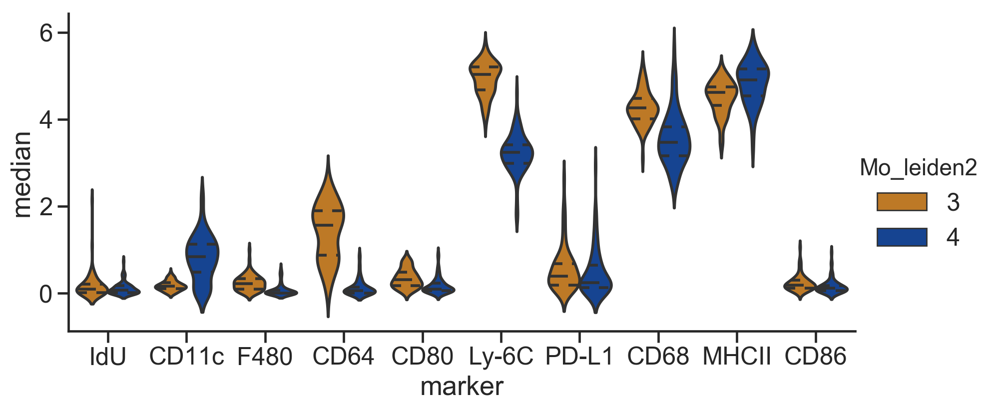

In [13]:
sns.set_style("ticks")
sns.catplot(x = 'marker', y = 'median', kind = 'violin',inner = 'quart',
            hue = 'Mo_leiden2', palette = Mo_leiden2_dict,
            scale='count', ci = 68, 
            data = median_df[median_df['marker'].isin(markers_int) & 
                             median_df['Mo_leiden2'].isin(['3', '4'])],
            legend_out = True, aspect = 2, height = 5)

In [21]:
Mo_name_dict = {'0':'Ly6Chi',
'1': 'Ly6Chi',
'2': 'Presenting_CD11c+PDL1+',
'3': 'Presenting_Ly6Cmid',
'4': 'Presenting_Ly6Clow',
'5': 'Patrolling_PDL1+',
'6': 'Phagocytic_PDL1+',
'7': 'Ly6Chi',
'8': 'Presenting_Ly6C-CD11c+',
'9': 'Proliferating',
'10': 'F480hi'}
mono_df.loc[:,'mo_type'] = mono_df['Mo_leiden2'].map(Mo_name_dict)

In [22]:
mono_df.to_csv(umap_path, index = False)

In [23]:
columns_int = ['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86', 'batch_run', 'timePI','cage','challenge', 'day', 'id', 'mo_type', 'compartment2']
mo_clean_df = mono_df[(mono_df['batch_run']=='2018') & 
                      (mono_df['test_status'] == 'test') &  
                      mono_df['compartment2'].isin(['PB-EV', 'PL-EV', 'PL-T'])]
pivot_series = mo_clean_df[columns_int].pivot_table(columns= ['mo_type','compartment2','challenge', 'cage','id', 'day'], aggfunc = 'median')

median_df = pd.DataFrame(pivot_series)
median_df.reset_index(inplace = True)
median_df.rename(columns = {'level_0': 'marker', 0: 'median'}, inplace = True)

In [24]:
mean_medians = median_df.groupby(['marker','mo_type']).mean()
mean_medians.reset_index(inplace = True)
heatmap_df = mean_medians.pivot_table(index = 'mo_type', columns = 'marker', values = 'median')
heatmap_ready = heatmap_df.apply(lambda x:(x-x.min()) / (x.max()-x.min()), axis = 0)

In [25]:
heatmap_ready

marker,B220,CD115,CD11b,CD11c,CD19,CD25,CD3,CD4,CD40,CD44,...,Ly-6C,Ly-6G,MHCII,NKp46,PD-1,PD-L1,Siglec-F,TCRb,TCRgd,c-Kit
mo_type,,,,,,,,,,,,,,,,,,,,,
F480hi,1.000000,1.000000,1.000000,0.124670,1.000000,1.000000,1.000000,0.000000,0.772804,0.922431,...,0.100547,1.000000,0.054589,0.266651,0.000000,0.192966,0.443778,1.000000,0.701272,0.179751
Ly6Chi,0.072659,0.140120,0.299075,0.000000,0.000000,0.034162,0.000000,0.326043,0.181190,0.628472,...,1.000000,0.006877,0.000000,0.000000,0.277954,0.000000,0.000000,0.000000,0.000000,0.000000
Patrolling_PDL1+,0.000000,0.257331,0.242798,0.628464,0.017733,0.000000,0.007757,0.599746,0.045956,0.499279,...,0.219667,0.000000,0.121017,0.152714,0.224901,0.822855,0.072470,0.201909,0.917150,0.081677
Phagocytic_PDL1+,0.318472,0.399165,0.438331,0.371335,0.216700,0.297111,0.134767,0.736189,0.367871,0.960786,...,0.581781,0.547155,0.075614,0.616820,0.204836,0.891562,0.578731,0.472999,1.000000,0.250818
Presenting_CD11c+PDL1+,0.310950,0.356893,0.367572,1.000000,0.140352,0.312207,0.137478,1.000000,1.000000,1.000000,...,0.607075,0.526842,1.000000,1.000000,1.000000,1.000000,0.987807,0.893011,0.864436,0.284102
Presenting_Ly6C-CD11c+,0.121404,0.122064,0.088441,0.740192,0.182693,0.101090,0.083371,0.439132,0.244937,0.124841,...,0.000000,0.056259,0.813015,0.410235,0.715154,0.310488,1.000000,0.597432,0.407817,1.000000
Presenting_Ly6Clow,0.055344,0.000000,0.000000,0.398440,0.032082,0.031234,0.022038,0.304108,0.205056,0.000000,...,0.534807,0.043644,0.700205,0.353863,0.361582,0.099293,0.779789,0.164213,0.159497,0.372726
Presenting_Ly6Cmid,0.078857,0.203061,0.290906,0.072469,0.069075,0.084820,0.040517,0.445585,0.171038,0.505293,...,0.871724,0.117491,0.636634,0.148243,0.417644,0.129319,0.172719,0.138246,0.171462,0.050009
Proliferating,0.311702,0.162740,0.116413,0.326909,0.111445,0.190244,0.059512,0.050621,0.000000,0.028536,...,0.468256,0.164059,0.434554,0.409710,0.351734,0.341223,0.476624,0.480667,0.398214,0.703527


In [26]:
Mo_leiden2_dict = {'Ly6Chi':'#66a61e',
'Presenting_CD11c+PDL1+': '#d6bcc0',
'Presenting_Ly6Cmid': '#876507',
'Presenting_Ly6Clow': '#d67c0d',
'Patrolling_PDL1+': '#023fa5',
'Phagocytic_PDL1+': '#e7298a',
'Presenting_Ly6C-CD11c+': '#d60d0d',
'Proliferating': '#7570b3',
'F480hi': '#772d91'}

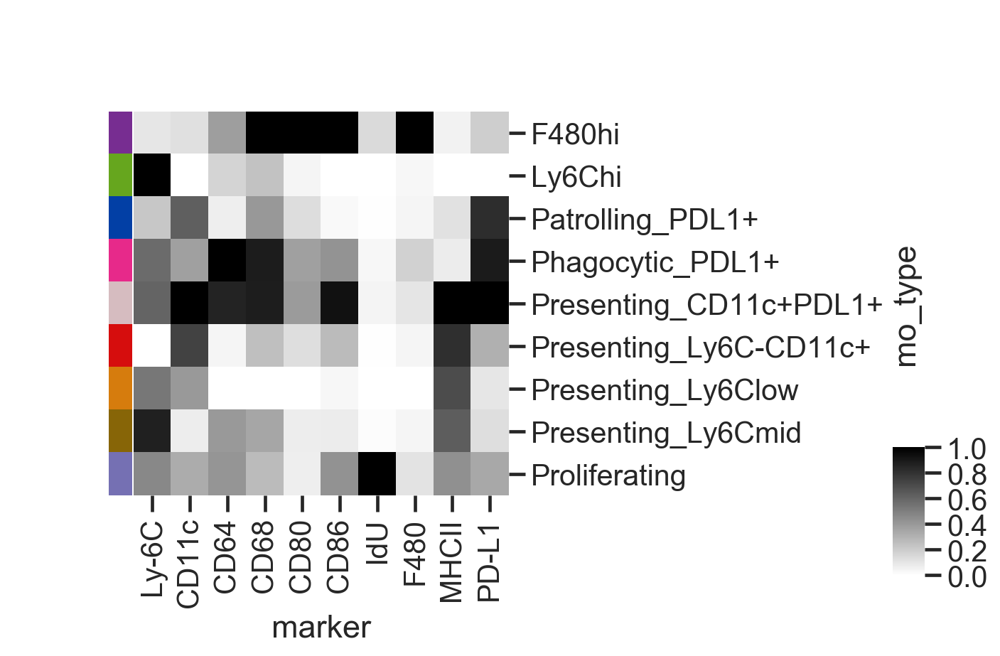

In [27]:
sns.set_context('talk', font_scale= 1)
row_colors = heatmap_ready.index.map(Mo_leiden2_dict)
cg = sns.clustermap(heatmap_ready.loc[:, markers_int], figsize=(5,5),
               cmap = 'binary', row_colors = row_colors,
               row_cluster = False, col_cluster = False)
plt.setp(cg.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
cg.cax.set_position((1.5,0.0,.05,.2))

In [28]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '20201103_Challengemaleandfemcombmaternal500wo_outliers_counts_per_sample_meta_clust.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
full_cell_counts= pd.read_csv(counts_filepath)
full_cell_counts.loc[:, ['cage', 'id']] = full_cell_counts.loc[:, ['cage', 'id']].astype(str)

In [29]:
mo_clean_df = mono_df[(mono_df['batch_run']=='2018') & 
                      (mono_df['test_status'] == 'test') & 
                      (mono_df['challenge'] == 'sal') & 
                      (mono_df['timePI'] == '2hr') & 
                      mono_df['compartment2'].isin(['PB-EV', 'PL-EV', 'PL-T'])]
cell_counts = pd.DataFrame(data = mo_clean_df.groupby(['mo_type', 'compartment2','day', 'challenge','timePI','cage', 'id', 'test_status']).apply(len))
cell_counts.reset_index(inplace = True)
cell_counts.rename(columns = {0: 'counts'}, inplace = True)
cell_counts['sample'] = cell_counts['cage'].astype(str).str.cat(cell_counts['id'].astype(str), sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['day'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['challenge'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['timePI'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['compartment2'], sep= '_')
sample_total = pd.DataFrame(data = cell_counts.groupby(['sample']).sum())
sample_dict = sample_total.to_dict()
cell_counts.loc[:,'sample_total'] = cell_counts['sample'].map(sample_dict['counts'])
cell_counts['frac_of_MPs'] = cell_counts['counts']/cell_counts['sample_total']
samp_total_df = full_cell_counts.loc[:, ['sample', 'sample_total']]
samp_total_df.set_index('sample', inplace = True)
total_counts_dict = samp_total_df.to_dict()
cell_counts.loc[:,'full_sample_total'] = cell_counts.loc[:,'sample'].map(total_counts_dict['sample_total'])
cell_counts['frac_of_immune'] = cell_counts['counts']/cell_counts['full_sample_total'] 

subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '20201207_nopld1clustmaternalmo_edited_counts_per_sample.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
cell_counts= pd.read_csv(counts_filepath)                                                 

In [30]:
cell_counts['cage'] = cell_counts['cage'].astype(str)
composite = cell_counts.groupby(['mo_type', 'day','compartment2']).agg(['mean', 'sem'])
mean_sem_comp = composite.reorder_levels([1, 0], axis = 1)

In [31]:
composite_frac_all = pd.DataFrame(data = mean_sem_comp['mean']['frac_of_MPs'])
composite_frac_all.reset_index(inplace = True)
heatmap_all = composite_frac_all.pivot_table(index = ['mo_type'], columns = 'compartment2', values = 'frac_of_MPs')
heatmap_all= heatmap_all.fillna(0)

In [32]:
heatmap_all=heatmap_all.loc[:,['PL-T', 'PL-EV', 'PB-EV']]

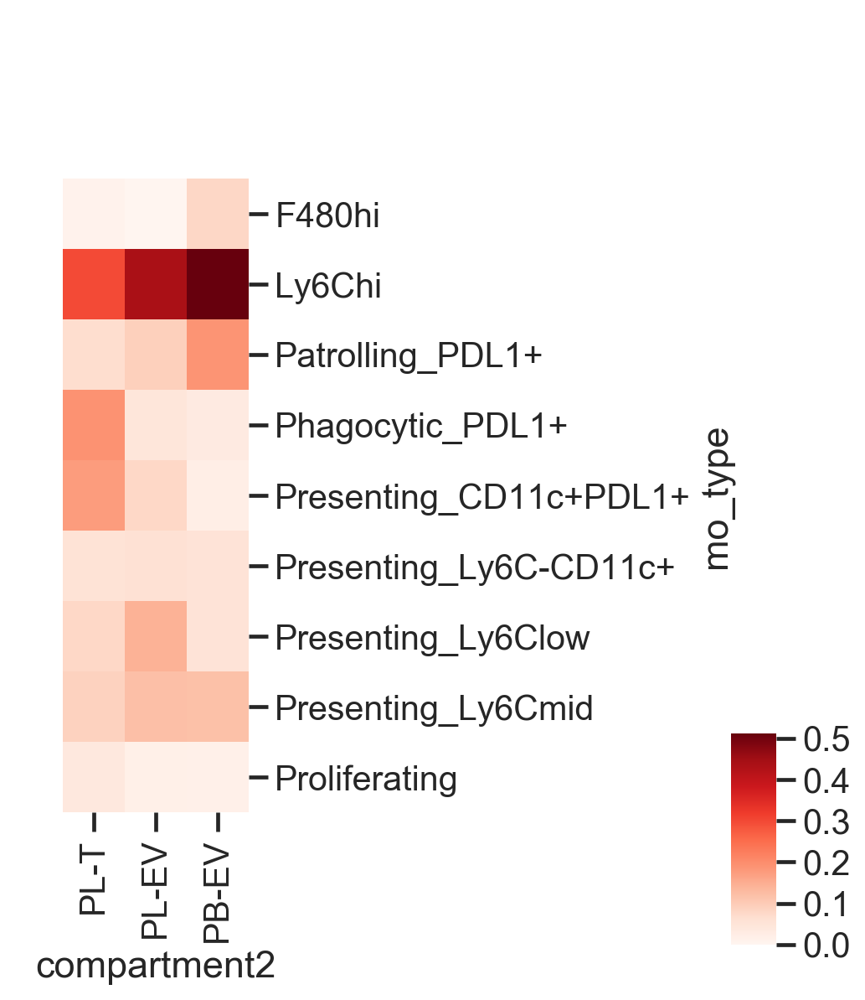

In [33]:
cg = sns.clustermap(heatmap_all, figsize=(2, 7),
               cmap = 'Reds',  
               row_cluster = False, col_cluster = False)
plt.setp(cg.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
cg.cax.set_position((2.5,0.0,.15,.2))

# Supplemental Figure 3C

In [34]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20201211_2018SALMo_maternal500wo_outliers.csv')
mono_df= pd.read_csv(umap_path)
mono_df.loc[:, ['cage', 'id', 'batch_run', 'Mo_leiden2']] = mono_df.loc[:, ['cage', 'id', 'batch_run', 'Mo_leiden2']].astype(str)

In [39]:
mono_df.head(5)

,CD45-retroorbital,CD45.2,CD45.1,IdU,B220,Ly-6G,CD11c,TCRb,CD115,CD69,...,compartment,leiden0,gen_cell_type,cell_type_v2,compartment2,batch_run,Mo_leiden2,umap1,umap2,mo_type
0,4.440127,3.113236,0.000000,0.917495,1.681932,1.248900,0.003837,0.565267,0.216015,0.009731,...,PL_F-EV,3,DCs,Monocytes,PL-EV,2018,3,-1.842028,3.591639,Presenting_Ly6Cmid
1,3.592813,2.023786,0.102777,0.323869,1.415480,0.299612,0.084553,0.009124,0.017124,0.009731,...,PL_F-EV,13,Mo,Monocytes,PL-EV,2018,4,-3.857234,0.348802,Presenting_Ly6Clow
2,1.471493,3.678320,0.000000,5.177753,1.015315,0.350451,2.000770,0.386624,0.791681,0.429151,...,PL_F-T,7,DCs,Monocytes,PL-T,2018,9,-4.122046,-3.444259,Proliferating
3,4.987449,3.573796,0.000000,0.001446,1.126140,0.601137,0.316771,0.057334,0.316629,0.009731,...,PL_F-EV,0,Mo,Monocytes,PL-EV,2018,0,3.146329,2.738417,Ly6Chi
4,1.782389,3.171191,0.287883,0.225362,0.278570,0.016804,2.255548,0.009124,0.017124,0.009731,...,PL_F-T,3,DCs,Monocytes,PL-T,2018,2,-4.529738,3.316543,Presenting_CD11c+PDL1+


In [40]:
mono_df['Ly-6C'][mono_df['compartment2']== 'PB-EV'].describe()

count    1450.000000
mean        4.090460
std         2.027924
min         0.031968
25%         2.752815
50%         4.947240
75%         5.672900
max         6.999508
Name: Ly-6C, dtype: float64

In [41]:
mono_df['canonical_cat']= 'non_classical'
int_mask = (mono_df['Ly-6C'] >= 3)
mono_df['canonical_cat'][int_mask] = 'intermediate'
class_mask = (mono_df['Ly-6C'] >= 4.5)
mono_df['canonical_cat'][class_mask] = 'classical'

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """


In [42]:
mono_class_dict = {'classical': '#babdc2',
                   'intermediate': '#2c2145',
                   'non_classical': '#f2f207'}

In [43]:
clean_mo_df  = mono_df[(mono_df['test_status'] == 'test') & 
                      mono_df['compartment2'].isin(['PB-EV', 'PL-EV', 'PL-T'])]

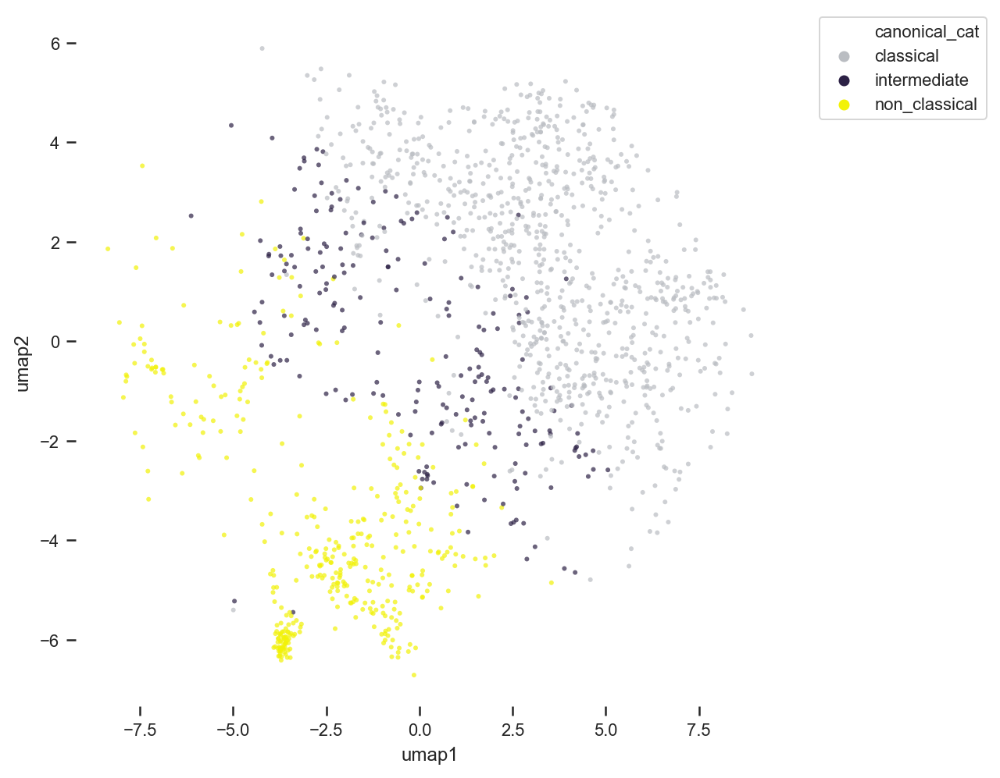

In [44]:
sns.set_context('paper', font_scale= 1)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.scatterplot(x='umap1', y='umap2', 
                data = clean_mo_df[clean_mo_df['compartment2'] == 'PB-EV'], 
                hue = 'canonical_cat',
                palette = mono_class_dict, 
                marker='.', linewidth = 0, alpha = 0.7)
sns.set_style("whitegrid", {'axes.grid' : False})
sns.despine(f, left=True, bottom=True)
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

In [45]:
class_cell_counts = pd.DataFrame(data = clean_mo_df.groupby(['canonical_cat','compartment2', 'challenge','day','timePI','cage','id']).apply(len))
class_cell_counts.reset_index(inplace = True)
class_cell_counts.rename(columns = {0: 'counts'}, inplace = True)
class_cell_counts['sample'] = class_cell_counts['cage'].str.cat(class_cell_counts['id'], sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['day'], sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['challenge'], sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['compartment2'], sep= '_')
sample_total = pd.DataFrame(data = class_cell_counts.groupby(['sample']).sum())
sample_dict = sample_total.to_dict()
class_cell_counts.loc[:,'sample_total'] = class_cell_counts['sample'].map(sample_dict['counts'])
class_cell_counts['frac_of_MPs'] = class_cell_counts['counts']/class_cell_counts['sample_total'] 

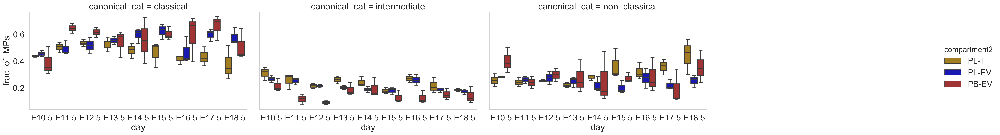

In [46]:
sns.set_context('talk', font_scale= 1.2)
sns.catplot(x = 'day', y = 'frac_of_MPs', kind = 'box', hue_order = ['PL-T', 'PL-EV', 'PB-EV'], col = 'canonical_cat',
            hue = 'compartment2', palette = {'PB-EV':'firebrick', 'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod'},
            ci = 68, data = class_cell_counts, col_wrap = 4,
            legend_out = True, aspect = 1.6, height = 5)

In [64]:
class_cell_counts = pd.DataFrame(data = clean_mo_df.groupby(['mo_type','canonical_cat','challenge','day','timePI','cage','id']).apply(len))
class_cell_counts.reset_index(inplace = True)
class_cell_counts.rename(columns = {0: 'counts'}, inplace = True)
class_cell_counts['sample'] = class_cell_counts['cage'].str.cat(class_cell_counts['id'], sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['day'], sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['challenge'], sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['mo_type'], sep= '_')
sample_total = pd.DataFrame(data = class_cell_counts.groupby(['sample']).sum())
sample_dict = sample_total.to_dict()
class_cell_counts.loc[:,'sample_total'] = class_cell_counts['sample'].map(sample_dict['counts'])
class_cell_counts['frac_of_MPs'] = class_cell_counts['counts']/class_cell_counts['sample_total'] 

In [65]:
bl_counts_piv = class_cell_counts.pivot_table(index = ['mo_type', 'id', 'cage', 'timePI'], columns = 'canonical_cat', values = 'frac_of_MPs')
bl_counts_piv.reset_index(inplace = True)

In [66]:
bl_counts_piv.head(5)

canonical_cat,mo_type,id,cage,timePI,classical,intermediate,non_classical
0,F480hi,10,6942,2hr,NaN,NaN,1.0
1,F480hi,10,9581,2hr,NaN,NaN,1.0
2,F480hi,11,9582,2hr,NaN,NaN,1.0
3,F480hi,13,428,2hr,NaN,NaN,1.0
4,F480hi,14,9582,2hr,NaN,NaN,1.0


In [67]:
bl_counts_piv.loc[:,'classical': 'non_classical'] = bl_counts_piv.loc[:,'classical': 'non_classical'].fillna(0)

In [68]:
bl_counts_piv.loc[:, 'id':'cage'] = bl_counts_piv.loc[:, 'id':'cage'].astype(str)

In [69]:
composite = bl_counts_piv.groupby(['mo_type']).agg(['mean', 'sem'])
mean_sem_comp = composite.reorder_levels([1, 0], axis = 1)
composite_T = mean_sem_comp['mean'].transpose()
composite_T.reset_index(inplace = True)

In [70]:
composite_T

mo_type,index,F480hi,Ly6Chi,Patrolling_PDL1+,Phagocytic_PDL1+,Presenting_CD11c+PDL1+,Presenting_Ly6C-CD11c+,Presenting_Ly6Clow,Presenting_Ly6Cmid,Proliferating
0,classical,0.000000,0.892561,0.015819,0.326682,0.330185,0.0,0.067735,0.715529,0.328768
1,intermediate,0.027778,0.090539,0.244608,0.261049,0.348821,0.0,0.531085,0.265487,0.172448
2,non_classical,0.972222,0.016900,0.739573,0.412269,0.320994,1.0,0.401180,0.018984,0.498784


In [71]:
composite_T.sum(axis = 0)

mo_type
index                     classicalintermediatenon_classical
F480hi                                                     1
Ly6Chi                                                     1
Patrolling_PDL1+                                           1
Phagocytic_PDL1+                                           1
Presenting_CD11c+PDL1+                                     1
Presenting_Ly6C-CD11c+                                     1
Presenting_Ly6Clow                                         1
Presenting_Ly6Cmid                                         1
Proliferating                                              1
dtype: object

In [72]:
composite_T[['index']]

mo_type,index
0,classical
1,intermediate
2,non_classical


In [73]:
int_to_mo_class = composite_T[['index']].to_dict()
bars_dict = {}
for mo_class in composite_T.index:
    bars_dict[mo_class] = composite_T.iloc[mo_class, 1:]
height_dict = {}
for mo_class in composite_T.index:
    height_dict[mo_class] = composite_T.iloc[mo_class+1:,1:].sum().tolist()

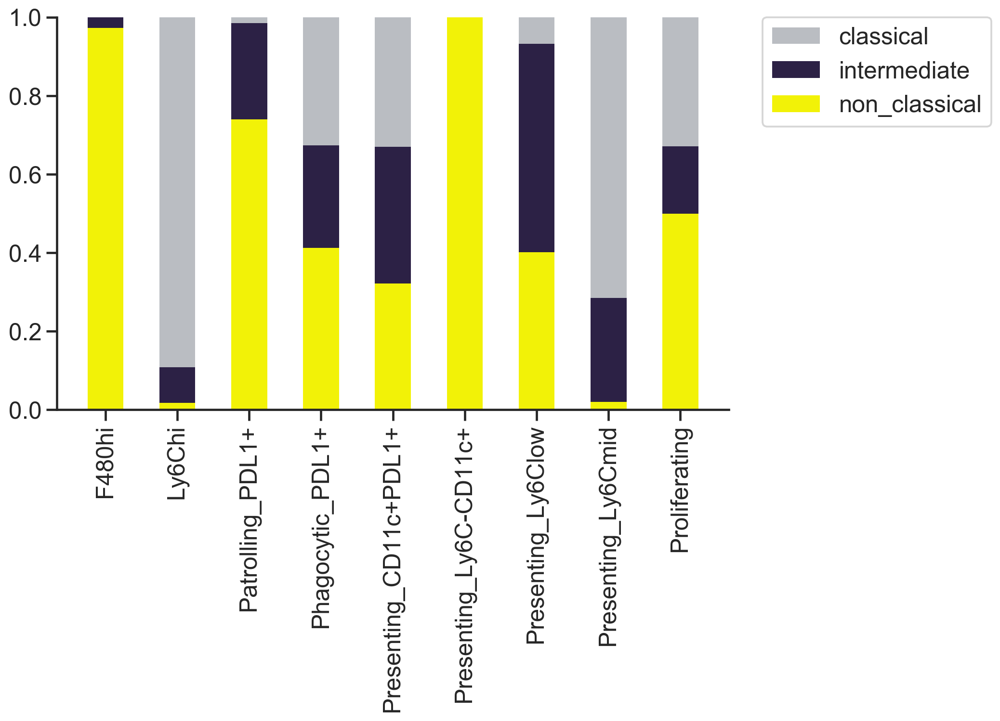

In [79]:
sns.set_style("ticks")
plt.figure(figsize=(10,6)) 
# The position of the bars on the x-axis
r = [0, 0.2, 0.4, 0.6, 0.8, 1.0, 1.2, 1.4, 1.6]
 
# Names of group and bar width
names = ['F480hi','Ly6Chi', 'Patrolling_PDL1+', 'Phagocytic_PDL1+', 'Presenting_CD11c+PDL1+', 'Presenting_Ly6C-CD11c+', 'Presenting_Ly6Clow','Presenting_Ly6Cmid','Proliferating']
barWidth = 0.10

for mo_class in composite_T.index:
    plt.bar(r, bars_dict[mo_class], color = mono_class_dict[int_to_mo_class['index'][mo_class]], bottom = height_dict[mo_class], width=barWidth, linewidth = 0)
plt.xticks(r, names,  rotation=90);
plt.legend(composite_T['index'], bbox_to_anchor=(1.05, 1), borderaxespad=0., ncol=1)
sns.despine(right = True, top = True)

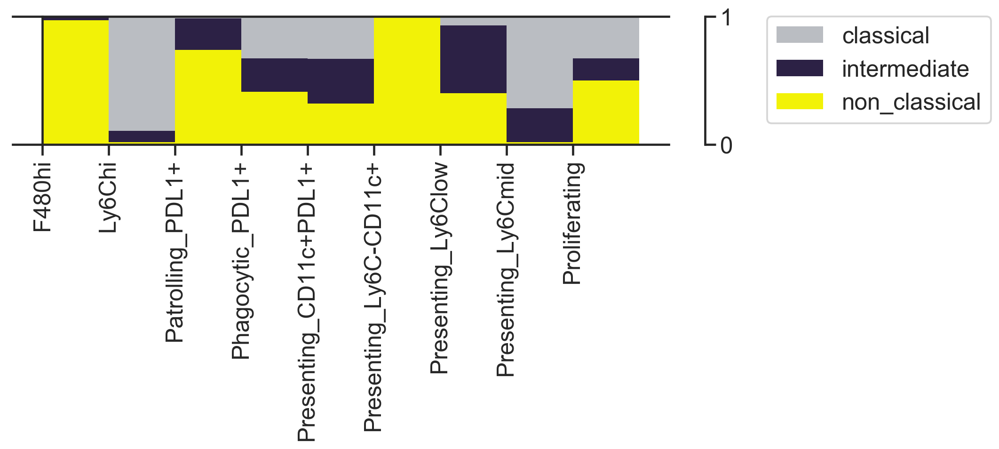

In [80]:
sns.set_style("ticks")
fig = plt.figure(figsize=(10,2))
ax = fig.add_subplot(1, 1, 1)
ax.spines['left'].set_position(('data', 0.0))
ax.spines['right'].set_position(('data', 1.0))
ax.yaxis.tick_right()

# The position of the bars on the x-axis
r = [0,0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]
 
# Names of group and bar width
names = ['F480hi','Ly6Chi', 'Patrolling_PDL1+', 'Phagocytic_PDL1+', 'Presenting_CD11c+PDL1+', 'Presenting_Ly6C-CD11c+', 'Presenting_Ly6Clow','Presenting_Ly6Cmid','Proliferating']
barWidth = 0.10

for mo_class in composite_T.index:
    plt.bar(r, bars_dict[mo_class], color = mono_class_dict[int_to_mo_class['index'][mo_class]], 
            bottom = height_dict[mo_class], width=barWidth, linewidth = 0, align = 'edge')
plt.xticks(r, names,  rotation=90);
plt.legend(composite_T['index'], bbox_to_anchor=(1.15, 1), borderaxespad=0., ncol=1)

# Figure 3D

In [3]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
mumap_path = os.path.join(subsample_path, '20201211_2018SALMo_maternal500wo_outliers.csv')
adata_df= pd.read_csv(mumap_path)
adata_df.loc[:, ['cage', 'id', 'batch_run']] = adata_df.loc[:, ['cage', 'id', 'batch_run']].astype(str)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3049: DtypeWarning: Columns (42) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [4]:
mo_columns_int = ['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86', 
               'cage','challenge', 'day', 'id', 'timePI','mo_type', 'compartment2']
mo_clean_df = adata_df[(adata_df['batch_run']=='2018') & (adata_df['test_status'] == 'test') & adata_df['compartment2'].isin(['PB-EV', 'PL-EV', 'PL-T'])]
pivot_series = mo_clean_df[mo_columns_int].pivot_table(columns= ['mo_type', 'compartment2','challenge', 'cage','id', 'day', 'timePI'], aggfunc = 'median')
mo_median_df = pd.DataFrame(pivot_series)
mo_median_df.reset_index(inplace = True)
mo_median_df.rename(columns = {'level_0': 'marker', 0: 'median'}, inplace = True)

In [5]:
Mo_leiden2_dict = {'Ly6Chi':'#66a61e',
'Presenting_CD11c+PDL1+': '#d6bcc0',
'Presenting_Ly6Cmid': '#876507',
'Presenting_Ly6Clow': '#d67c0d',
'Patrolling_PDL1+': '#023fa5',
'Phagocytic_PDL1+': '#e7298a',
'Presenting_Ly6C-CD11c+': '#d60d0d',
'Proliferating': '#7570b3',
'F480hi': '#772d91'}

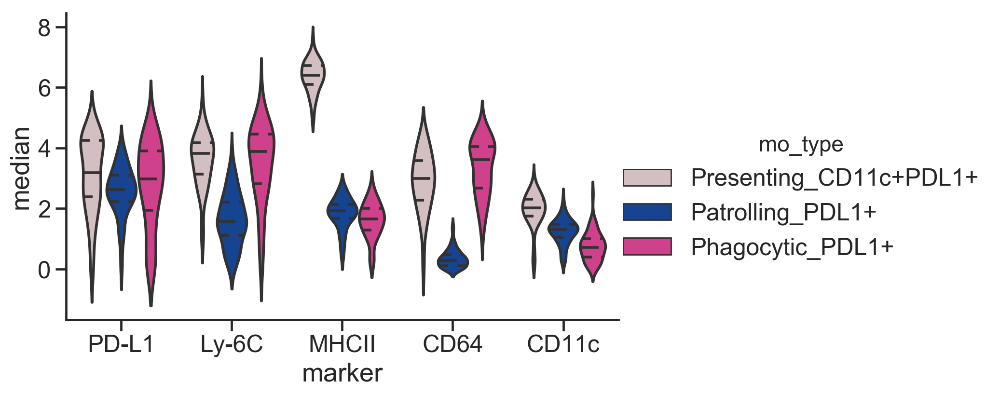

In [7]:
median_df = mo_median_df[(mo_median_df['timePI'] == '2hr') & (mo_median_df['challenge'] == 'sal')]
sns.set_style("ticks")
sns.catplot(x = 'marker', y = 'median', kind = 'violin',inner = 'quart',
            hue = 'mo_type', hue_order = ['Presenting_CD11c+PDL1+', 'Patrolling_PDL1+','Phagocytic_PDL1+'], palette = Mo_leiden2_dict, order = ['PD-L1', 'Ly-6C','MHCII', 'CD64', 'CD11c'],
            scale='count', ci = 68, data = median_df[median_df['marker'].isin(['PD-L1', 'Ly-6C','MHCII', 'CD64', 'CD11c']) & median_df['mo_type'].isin(['Presenting_CD11c+PDL1+', 'Patrolling_PDL1+','Phagocytic_PDL1+'])],
            legend_out = True, aspect = 1.6, height = 5)

In [262]:
from scipy.stats import ttest_ind

In [66]:
t_test_data = pd.DataFrame(columns =['cluster1', 'cluster2', 'marker','t-stat', 'p-value', 'Stat diff'])

In [67]:
leiden_combos = [('0', '5'), ('0', '7'), ('5', '7')]

In [68]:
for leiden_comb in leiden_combos:
    for marker in ['PD-L1', 'Ly-6C','MHCII', 'CD64']:
    
            marker_leiden1 = median_df[(median_df['marker']== marker) & 
                                    (median_df['Mo_leiden2']== leiden_comb[0])]
            marker_leiden2 = median_df[(median_df['marker']== marker) & 
                                    (median_df['Mo_leiden2']== leiden_comb[1])]

            t_stat, p = ttest_ind(marker_leiden1['median'], marker_leiden2['median'])
            alpha = 0.05
            if p > alpha:
                dist = 'no'
            else:
                dist = 'yes'
            data_df = pd.DataFrame(data ={'cluster1': [leiden_comb[0]],
                                          'cluster2': [leiden_comb[1]],
                                          'marker': [marker], 
                                          't-stat': [t_stat], 
                                          'p-value': [p], 
                                          'Stat diff':[ dist]})
            t_test_data = t_test_data.append(data_df)

In [69]:
t_test_data

,cluster1,cluster2,marker,t-stat,p-value,Stat diff
0,0,5,PD-L1,-4.448296,1.343290e-05,yes
0,0,5,Ly-6C,23.884598,1.882287e-64,yes
0,0,5,MHCII,42.873642,3.052953e-112,yes
0,0,5,CD64,21.246851,2.398973e-56,yes
0,0,7,PD-L1,-7.764782,4.763171e-13,yes
0,0,7,Ly-6C,15.803163,1.389232e-36,yes
0,0,7,MHCII,32.853985,9.576712e-81,yes
0,0,7,CD64,-14.399058,2.337539e-32,yes
0,5,7,PD-L1,-5.547858,9.094408e-08,yes
0,5,7,Ly-6C,-4.461513,1.356929e-05,yes


# Figure 3D supplementary

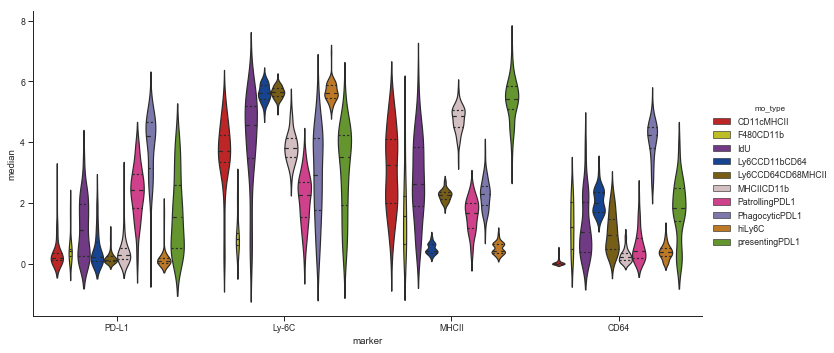

In [258]:
sns.set_style("ticks")
sns.catplot(x = 'marker', y = 'median', kind = 'violin',inner = 'quart',
            hue = 'mo_type', palette = Mo_leiden2_dict, order = ['PD-L1', 'Ly-6C','MHCII', 'CD64'],
            scale='count', ci = 68, data = median_df[median_df['marker'].isin(['PD-L1', 'Ly-6C','MHCII', 'CD64'])],
            legend_out = True, aspect = 2, height = 5)

In [12]:
from scipy.stats import ttest_ind
t_test_data = pd.DataFrame(columns =['cluster1', 'cluster2', 'marker','t-stat', 'p-value', 'Stat diff'])
leiden_combos = [('0', '4'), ('0', '5'), ('0', '7'), ('0', '8'), ('4', '5'), ('4', '7'), ('4', '8'), ('5', '7'), ('5', '8'), ('7', '8')]
for leiden_comb in leiden_combos:
    for marker in ['PD-L1', 'Ly-6C','MHCII', 'CD64']:
    
            marker_leiden1 = median_df[(median_df['marker']== marker) & 
                                    (median_df['Mo_leiden2']== leiden_comb[0])]
            marker_leiden2 = median_df[(median_df['marker']== marker) & 
                                    (median_df['Mo_leiden2']== leiden_comb[1])]

            t_stat, p = ttest_ind(marker_leiden1['median'], marker_leiden2['median'])
            alpha = 0.05
            if p > alpha:
                dist = 'no'
            else:
                dist = 'yes'
            data_df = pd.DataFrame(data ={'cluster1': [leiden_comb[0]],
                                          'cluster2': [leiden_comb[1]],
                                          'marker': [marker], 
                                          't-stat': [t_stat], 
                                          'p-value': [p], 
                                          'Stat diff':[ dist]})
            t_test_data = t_test_data.append(data_df)

In [13]:
t_test_data

,cluster1,cluster2,marker,t-stat,p-value,Stat diff
0,0,4,PD-L1,8.797054,3.520558e-16,yes
0,0,4,Ly-6C,-13.090119,1.425131e-29,yes
0,0,4,MHCII,60.797365,7.092695e-143,yes
0,0,4,CD64,2.161952,3.166297e-02,yes
0,0,5,PD-L1,-4.448296,1.343290e-05,yes
0,0,5,Ly-6C,23.884598,1.882287e-64,yes
0,0,5,MHCII,42.873642,3.052953e-112,yes
0,0,5,CD64,21.246851,2.398973e-56,yes
0,0,7,PD-L1,-7.764782,4.763171e-13,yes
0,0,7,Ly-6C,15.803163,1.389232e-36,yes


# Figure 3E

In [96]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
mumap_path = os.path.join(subsample_path, '20201211_2018SALMo_maternal500wo_outliers.csv')
adata_df= pd.read_csv(mumap_path)
adata_df.loc[:, ['cage', 'id', 'batch_run']] = adata_df.loc[:, ['cage', 'id', 'batch_run']].astype(str)

In [97]:
adata_df['compartment2'].unique()

array(['PL-EV', 'PL-T', 'PB-EV', nan], dtype=object)

In [98]:
mono_clean_df = adata_df[(adata_df['batch_run']=='2018') & 
                         (adata_df['test_status'] == 'test') & 
                         (adata_df['challenge'] == 'sal') &
                         (adata_df['timePI'] == '2hr') &
                         adata_df['compartment2'].isin(['PB-EV', 'PL-EV', 'PL-T'])]

In [99]:
PB = mono_clean_df[mono_clean_df['compartment2'] == 'PB-EV']
EV = mono_clean_df[mono_clean_df['compartment2'] == 'PL-EV']
TIS =mono_clean_df[mono_clean_df['compartment2']=='PL-T']

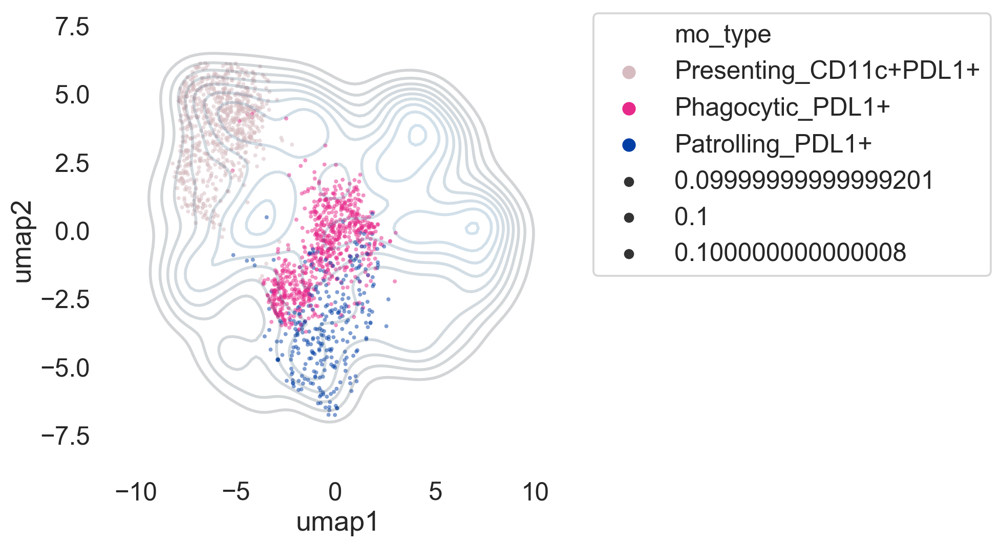

In [102]:
sns.set_context('talk', font_scale= 1.2)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = mono_clean_df['umap1'], data2= mono_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = TIS[TIS['mo_type'].isin(['Presenting_CD11c+PDL1+', 'Patrolling_PDL1+','Phagocytic_PDL1+'])], hue = 'mo_type', palette = Mo_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

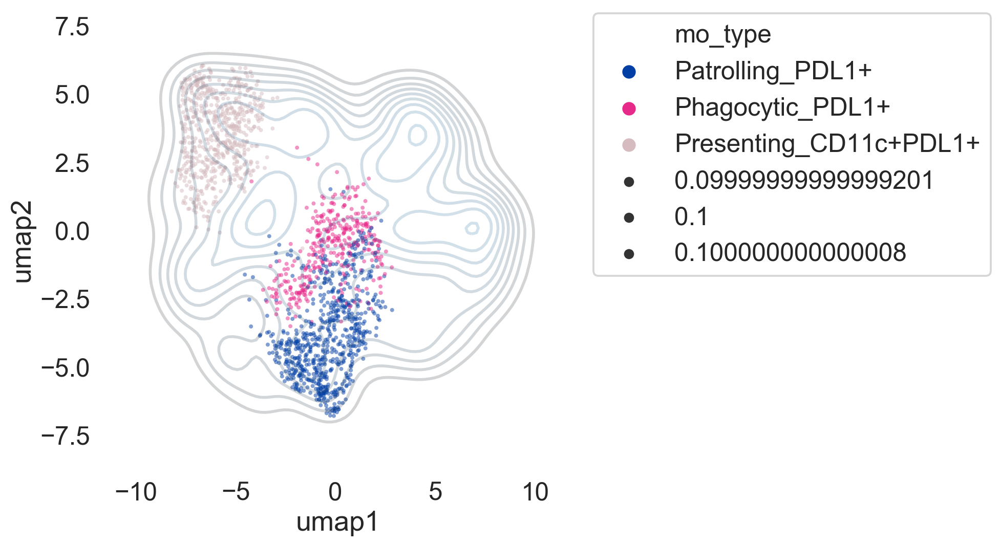

In [103]:
sns.set_context('talk', font_scale= 1.2)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = mono_clean_df['umap1'], data2= mono_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = EV[EV['mo_type'].isin(['Presenting_CD11c+PDL1+', 'Patrolling_PDL1+','Phagocytic_PDL1+'])], hue = 'mo_type', palette = Mo_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

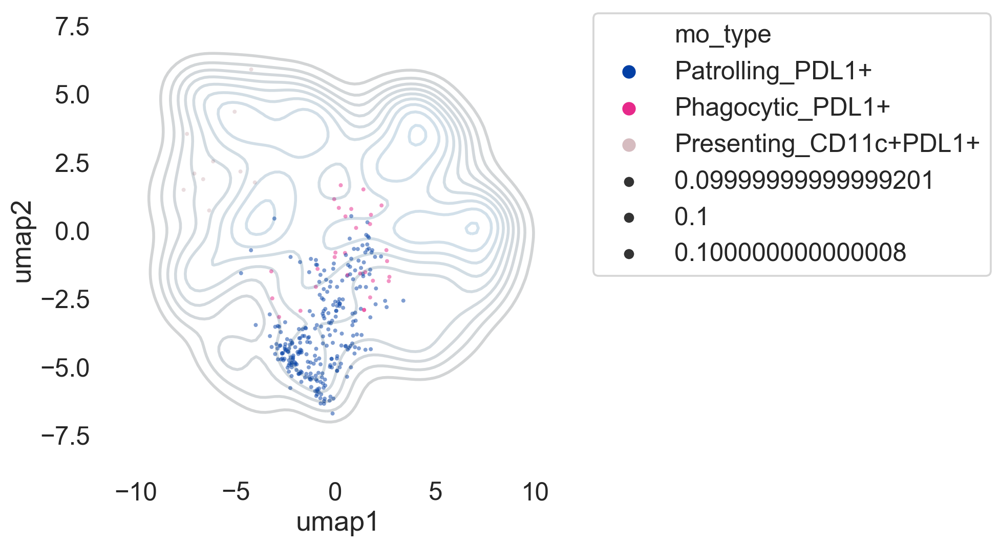

In [104]:
sns.set_context('talk', font_scale= 1.2)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = mono_clean_df['umap1'], data2= mono_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = PB[PB['mo_type'].isin(['Presenting_CD11c+PDL1+', 'Patrolling_PDL1+','Phagocytic_PDL1+'])], hue = 'mo_type', palette = Mo_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Supp Figure 3E

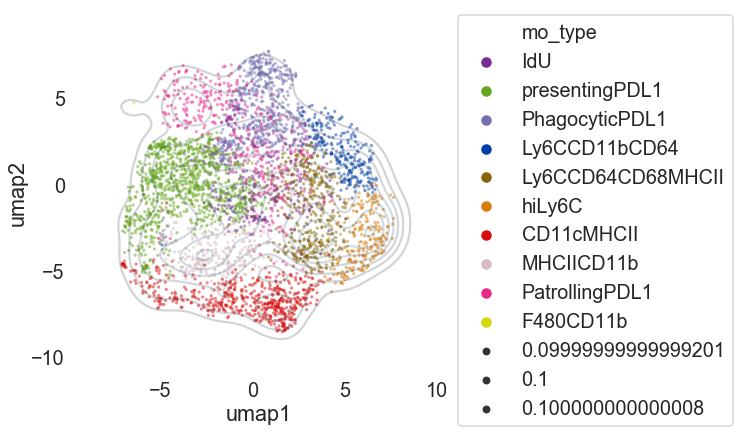

In [271]:
sns.set_context('talk', font_scale= 1.2)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = mono_clean_df['umap1'], data2= mono_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = TIS, hue = 'mo_type', palette = Mo_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

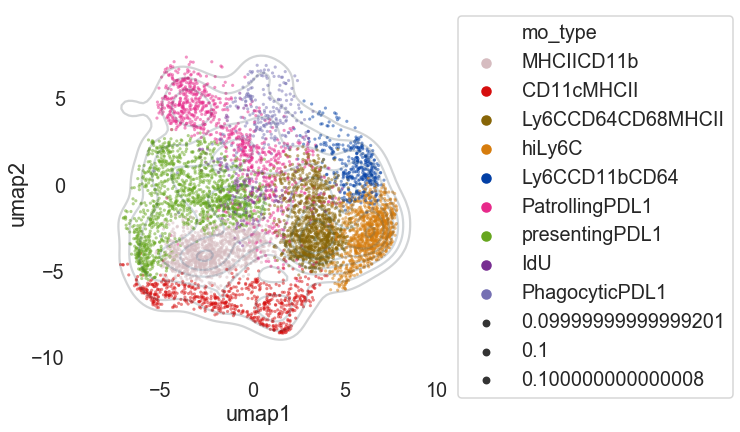

In [273]:
sns.set_context('talk', font_scale= 1.2)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = mono_clean_df['umap1'], data2= mono_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = EV, hue = 'mo_type', palette = Mo_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

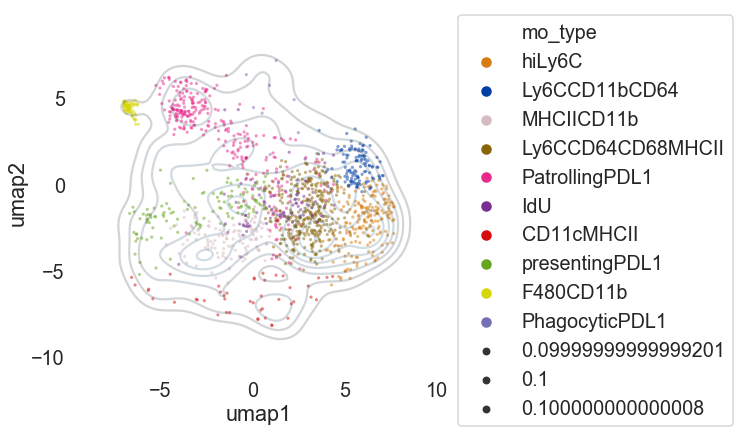

In [274]:
sns.set_context('talk', font_scale= 1.2)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = mono_clean_df['umap1'], data2= mono_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = PB, hue = 'mo_type', palette = Mo_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Figure 3F

In [29]:
comp_dict = {'PB-EV':'firebrick', 'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod'}

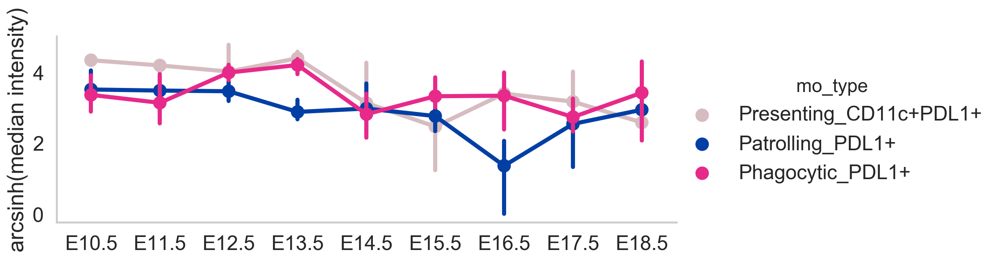

In [105]:
g = sns.catplot(x='day', y='median', hue='mo_type', height=4, aspect=2.5, sharey= True, order = ['E10.5', 'E11.5', 'E12.5', 'E13.5', 'E14.5', 'E15.5', 'E16.5', 'E17.5', 'E18.5'],
               data=median_df[median_df['marker'].isin(['PD-L1']) & median_df['mo_type'].isin(['Presenting_CD11c+PDL1+', 'Patrolling_PDL1+','Phagocytic_PDL1+']) & median_df['compartment2'].isin(['PL-T'])], 
                kind='point', palette = Mo_leiden2_dict,
               hue_order = ['Presenting_CD11c+PDL1+', 'Patrolling_PDL1+','Phagocytic_PDL1+'])
(g.set_axis_labels('', 'arcsinh(median intensity)')
  .set_titles('{row_name}'))  

In [17]:
median_df.head(5)

,marker,Mo_leiden2,compartment2,challenge,cage,id,day,median
0,CD45-retroorbital,0,PB-EV,sal,428,14,E12.5,4.603326
1,CD45-retroorbital,0,PB-EV,sal,429,16,E18.5,4.903420
2,CD45-retroorbital,0,PB-EV,sal,429,20,E18.5,4.715041
3,CD45-retroorbital,0,PB-EV,sal,439,6,E14.5,0.041249
4,CD45-retroorbital,0,PB-EV,sal,748,5,E12.5,1.707534


In [18]:
from scipy.stats import ttest_ind
days = ['E10.5', 'E11.5', 'E12.5', 'E13.5', 'E14.5', 'E15.5', 'E16.5', 'E17.5', 'E18.5']
combos = [('0', '5'), ('0', '7'), ('5', '7')]
markers = ['IdU']
t_test_mo_marker = pd.DataFrame(columns =['day', 'clust1', 'clust2', 't-stat_comp', 'p-value_comp', 'Stat diff comp'])

for marker in markers: 
    for day in days:
        for comb in combos:
                comp_1 = median_df[(median_df['marker']== marker) & 
                                        (median_df['Mo_leiden2']== comb[0])&
                                        (median_df['day']== day)]
                comp_2 = median_df[(median_df['marker']== marker) & 
                                        (median_df['Mo_leiden2']== comb[1])&
                                        (median_df['day']== day)]

                t_stat_comp, p_comp = ttest_ind(comp_1['median'], comp_2['median'])
                alpha = 0.05
                if p_comp > alpha:
                    dist_comp = 'no'
                else:
                    dist_comp = 'yes'


                data_df = pd.DataFrame(data ={'day':[day],
                                              'clust1': [comb[0]],
                                              'clust2': [comb[1]],
                                              't-stat_comp': [t_stat_comp], 
                                              'p-value_comp': [p_comp], 
                                              'Stat diff comp':[dist_comp]})
                t_test_mo_marker = t_test_mo_marker.append(data_df)

In [19]:
t_test_mo_marker

,day,clust1,clust2,t-stat_comp,p-value_comp,Stat diff comp
0,E10.5,0,5,-0.609777,0.548875,no
0,E10.5,0,7,-2.173302,0.045119,yes
0,E10.5,5,7,-1.847170,0.083299,no
0,E11.5,0,5,1.280865,0.218497,no
0,E11.5,0,7,0.231235,0.821028,no
0,E11.5,5,7,-1.318744,0.208421,no
0,E12.5,0,5,0.225622,0.822474,no
0,E12.5,0,7,-0.704501,0.485532,no
0,E12.5,5,7,-0.920657,0.363358,no
0,E13.5,0,5,0.763989,0.456724,no


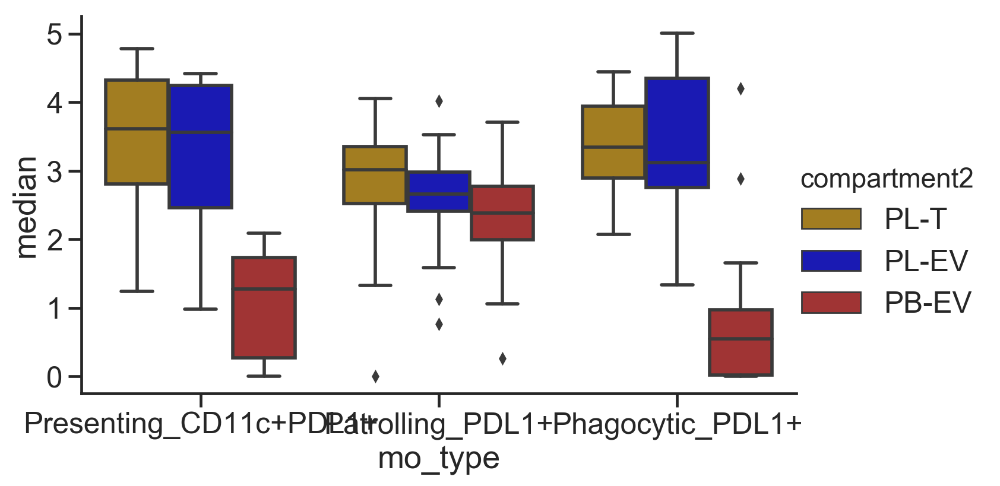

In [106]:
sns.set_style("ticks")
sns.catplot(x = 'mo_type', order = ['Presenting_CD11c+PDL1+', 'Patrolling_PDL1+','Phagocytic_PDL1+'],y = 'median', kind = 'box', hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
            hue = 'compartment2', palette = {'PB-EV':'firebrick', 'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod'},
            ci = 68, data = median_df[median_df['marker'].isin(['PD-L1']) 
                                      & median_df['mo_type'].isin(['Presenting_CD11c+PDL1+', 'Patrolling_PDL1+','Phagocytic_PDL1+'])],
            legend_out = True, aspect = 1.6, height = 5)

In [ ]:
from scipy.stats import ttest_ind

In [83]:
median_df.head(5)

,marker,Mo_leiden2,compartment2,challenge,cage,id,day,median
0,CD45-retroorbital,0,PB-EV,sal,428,14,E12.5,4.603326
1,CD45-retroorbital,0,PB-EV,sal,429,16,E18.5,4.903420
2,CD45-retroorbital,0,PB-EV,sal,429,20,E18.5,4.715041
3,CD45-retroorbital,0,PB-EV,sal,439,6,E14.5,0.041249
4,CD45-retroorbital,0,PB-EV,sal,748,5,E12.5,1.707534


In [84]:
pdl1_medians = median_df[median_df['marker'] == 'PD-L1']

In [85]:
t_test_pdl1 = pd.DataFrame(columns =['comp1', 'comp2', 'cluster','t-stat', 'p-value', 'Stat diff'])

In [86]:
combos = [('PL-T', 'PL-EV'), ('PL-T', 'PB-EV'),('PL-EV', 'PB-EV')]

In [87]:
for comb in combos:
    for cluster in ['0', '5','7']:
    
            comp1 = pdl1_medians[(pdl1_medians['Mo_leiden2']== cluster) & 
                                    (pdl1_medians['compartment2']== comb[0])]
            comp2 = pdl1_medians[(pdl1_medians['Mo_leiden2']== cluster) & 
                                    (pdl1_medians['compartment2']== comb[1])]

            t_stat, p = ttest_ind(comp1['median'], comp2['median'])
            alpha = 0.05
            if p > alpha:
                dist = 'no'
            else:
                dist = 'yes'
            data_df = pd.DataFrame(data ={'comp1': [comb[0]],
                                          'comp2': [comb[1]],
                                          'cluster': [cluster], 
                                          't-stat': [t_stat], 
                                          'p-value': [p], 
                                          'Stat diff':[ dist]})
            t_test_pdl1 = t_test_pdl1.append(data_df)

In [88]:
t_test_pdl1 

,comp1,comp2,cluster,t-stat,p-value,Stat diff
0,PL-T,PL-EV,0,6.287519,1.483718e-08,yes
0,PL-T,PL-EV,5,2.826176,5.947359e-03,yes
0,PL-T,PL-EV,7,-2.103178,3.885013e-02,yes
0,PL-T,PB-EV,0,9.925185,4.052746e-15,yes
0,PL-T,PB-EV,5,5.446111,5.512350e-07,yes
0,PL-T,PB-EV,7,1.266058,2.116026e-01,no
0,PL-EV,PB-EV,0,4.891791,6.730013e-06,yes
0,PL-EV,PB-EV,5,2.474621,1.556671e-02,yes
0,PL-EV,PB-EV,7,2.317030,2.665784e-02,yes


# Supp Figure 3F

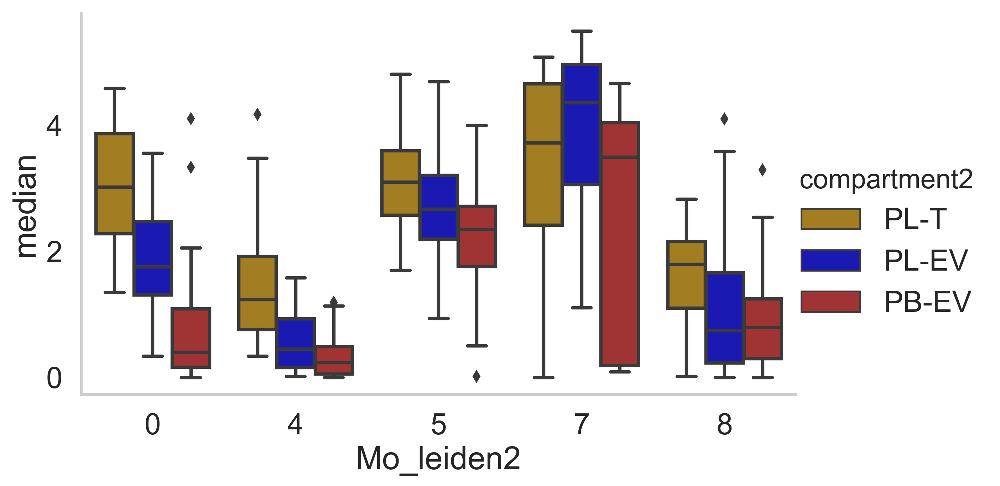

In [19]:
sns.catplot(x = 'Mo_leiden2', y = 'median', kind = 'box', hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
            hue = 'compartment2', palette = {'PB-EV':'firebrick', 'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod'},
            ci = 68, data = median_df[median_df['marker'].isin(['PD-L1']) & median_df['Mo_leiden2'].isin(['0', '4', '5', '7', '8'])],
            legend_out = True, aspect = 1.6, height = 5)

In [20]:
pdl1_medians = median_df[median_df['marker'] == 'PD-L1']
t_test_pdl1 = pd.DataFrame(columns =['comp1', 'comp2', 'cluster','t-stat', 'p-value', 'Stat diff'])
combos = [('PL-T', 'PL-EV'), ('PL-T', 'PB-EV'),('PL-EV', 'PB-EV')]
for comb in combos:
    for cluster in ['0', '4', '5','7', '8']:
    
            comp1 = pdl1_medians[(pdl1_medians['Mo_leiden2']== cluster) & 
                                    (pdl1_medians['compartment2']== comb[0])]
            comp2 = pdl1_medians[(pdl1_medians['Mo_leiden2']== cluster) & 
                                    (pdl1_medians['compartment2']== comb[1])]

            t_stat, p = ttest_ind(comp1['median'], comp2['median'])
            alpha = 0.05
            if p > alpha:
                dist = 'no'
            else:
                dist = 'yes'
            data_df = pd.DataFrame(data ={'comp1': [comb[0]],
                                          'comp2': [comb[1]],
                                          'cluster': [cluster], 
                                          't-stat': [t_stat], 
                                          'p-value': [p], 
                                          'Stat diff':[ dist]})
            t_test_pdl1 = t_test_pdl1.append(data_df)

In [21]:
t_test_pdl1

,comp1,comp2,cluster,t-stat,p-value,Stat diff
0,PL-T,PL-EV,0,6.287519,1.483718e-08,yes
0,PL-T,PL-EV,4,5.717353,1.746087e-07,yes
0,PL-T,PL-EV,5,2.826176,5.947359e-03,yes
0,PL-T,PL-EV,7,-2.103178,3.885013e-02,yes
0,PL-T,PL-EV,8,2.153158,3.456505e-02,yes
0,PL-T,PB-EV,0,9.925185,4.052746e-15,yes
0,PL-T,PB-EV,4,6.906520,1.248876e-09,yes
0,PL-T,PB-EV,5,5.446111,5.512350e-07,yes
0,PL-T,PB-EV,7,1.266058,2.116026e-01,no
0,PL-T,PB-EV,8,3.024502,3.582091e-03,yes


# Figure 3G

In [107]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
mumap_path = os.path.join(subsample_path, '20201211_2018SALMo_maternal500wo_outliers.csv')
adata_df= pd.read_csv(mumap_path)
adata_df.loc[:, ['cage', 'id', 'batch_run']] = adata_df.loc[:, ['cage', 'id', 'batch_run']].astype(str)

In [108]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '20201103_Challengemaleandfemcombmaternal500wo_outliers_counts_per_sample_meta_clust.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
full_cell_counts= pd.read_csv(counts_filepath)
full_cell_counts.loc[:, ['cage', 'id']] = full_cell_counts.loc[:, ['cage', 'id']].astype(str)

In [109]:
clean_mo_df = adata_df[(adata_df['batch_run']=='2018') & (adata_df['test_status']=='test')]
class_cell_counts = pd.DataFrame(data = clean_mo_df.groupby(['mo_type', 'challenge','compartment2','day','timePI','cage','id']).apply(len))
class_cell_counts.reset_index(inplace = True)
class_cell_counts.rename(columns = {0: 'counts'}, inplace = True)
class_cell_counts['sample'] = class_cell_counts['cage'].astype(str).str.cat(class_cell_counts['id'], sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['day'], sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['challenge'], sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['timePI'], sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['compartment2'], sep= '_')
sample_total = pd.DataFrame(data = class_cell_counts.groupby(['sample']).sum())
sample_dict = sample_total.to_dict()
class_cell_counts.loc[:,'sample_total'] = class_cell_counts['sample'].map(sample_dict['counts'])
class_cell_counts['frac_of_MPs'] = class_cell_counts['counts']/class_cell_counts['sample_total'] 
samp_total_df = full_cell_counts.loc[:, ['sample', 'sample_total']]
samp_total_df.set_index('sample', inplace = True)
total_counts_dict = samp_total_df.to_dict()
class_cell_counts.loc[:,'full_sample_total'] = class_cell_counts.loc[:,'sample'].map(total_counts_dict['sample_total'])
class_cell_counts['frac_of_immune'] = class_cell_counts['counts']/class_cell_counts['full_sample_total'] 

In [110]:
clean_cell_counts = class_cell_counts[(class_cell_counts['challenge'] == 'sal') &
                                     (class_cell_counts['timePI'] == '2hr')&
                                     class_cell_counts['compartment2'].isin(['PB-EV', 'PL-EV', 'PL-T'])]

In [111]:
clean_cell_counts.head(5)

,mo_type,challenge,compartment2,day,timePI,cage,id,counts,sample,sample_total,frac_of_MPs,full_sample_total,frac_of_immune
0,F480hi,sal,PB-EV,E10.5,2hr,6942,8,8,6942_8_E10.5_sal_2hr_PB-EV,60,0.133333,494,0.016194
1,F480hi,sal,PB-EV,E10.5,2hr,6944,16,3,6944_16_E10.5_sal_2hr_PB-EV,67,0.044776,496,0.006048
2,F480hi,sal,PB-EV,E10.5,2hr,9582,15,3,9582_15_E10.5_sal_2hr_PB-EV,36,0.083333,459,0.006536
3,F480hi,sal,PB-EV,E11.5,2hr,6942,10,3,6942_10_E11.5_sal_2hr_PB-EV,70,0.042857,462,0.006494
4,F480hi,sal,PB-EV,E13.5,2hr,9583,19,4,9583_19_E13.5_sal_2hr_PB-EV,59,0.067797,485,0.008247


In [112]:
int_days = ['E10.5', 'E14.5', 'E18.5']

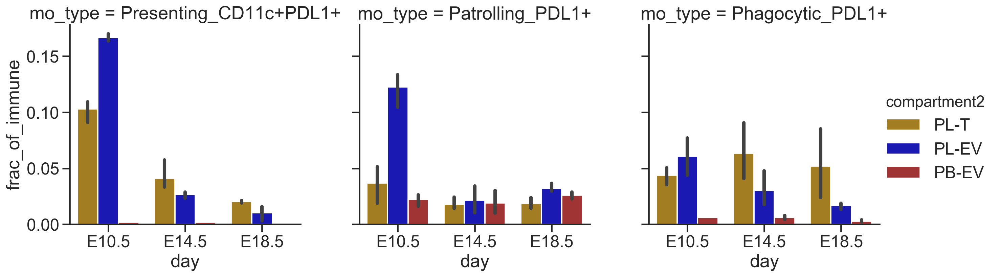

In [113]:
sns.set_style("ticks")
g = sns.catplot(x='day', y='frac_of_immune', col_order = ['Presenting_CD11c+PDL1+', 'Patrolling_PDL1+','Phagocytic_PDL1+'],
                col='mo_type', 
                data= clean_cell_counts[clean_cell_counts['day'].isin(int_days) 
                                        & clean_cell_counts['mo_type'].isin(['Presenting_CD11c+PDL1+', 'Patrolling_PDL1+','Phagocytic_PDL1+'])], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

In [114]:
clean_cell_counts['PDL1_status'] = np.where(clean_cell_counts['mo_type'].isin(['Presenting_CD11c+PDL1+', 'Patrolling_PDL1+','Phagocytic_PDL1+']), 'pos', 'neg')
PDL1_counts_df = clean_cell_counts.groupby(['PDL1_status', 'sample']).sum()
pdl1_dict = PDL1_counts_df.loc['pos', 'counts'].to_dict()

clean_cell_counts.loc[:,'pdl1_counts'] = clean_cell_counts.loc[:,'sample'].map(pdl1_dict)
pdl1_clust = clean_cell_counts[clean_cell_counts['mo_type'].isin(['Presenting_CD11c+PDL1+', 'Patrolling_PDL1+','Phagocytic_PDL1+'])]
pdl1_clust['frac_of_pdl1_pos'] = pdl1_clust['counts']/clean_cell_counts['pdl1_counts'] 

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  import sys


In [115]:
pdl1_clust.head()

,mo_type,challenge,compartment2,day,timePI,cage,id,counts,sample,sample_total,frac_of_MPs,full_sample_total,frac_of_immune,PDL1_status,pdl1_counts,frac_of_pdl1_pos
96,Patrolling_PDL1+,sal,PB-EV,E10.5,2hr,6942,8,8,6942_8_E10.5_sal_2hr_PB-EV,60,0.133333,494,0.016194,pos,12,0.666667
97,Patrolling_PDL1+,sal,PB-EV,E10.5,2hr,6944,16,13,6944_16_E10.5_sal_2hr_PB-EV,67,0.194030,496,0.026210,pos,17,0.764706
98,Patrolling_PDL1+,sal,PB-EV,E10.5,2hr,9582,15,11,9582_15_E10.5_sal_2hr_PB-EV,36,0.305556,459,0.023965,pos,11,1.000000
99,Patrolling_PDL1+,sal,PB-EV,E11.5,2hr,429,19,22,429_19_E11.5_sal_2hr_PB-EV,107,0.205607,482,0.045643,pos,22,1.000000
100,Patrolling_PDL1+,sal,PB-EV,E11.5,2hr,6942,10,14,6942_10_E11.5_sal_2hr_PB-EV,70,0.200000,462,0.030303,pos,14,1.000000


In [116]:
int_days = ['E10.5', 'E14.5', 'E18.5']

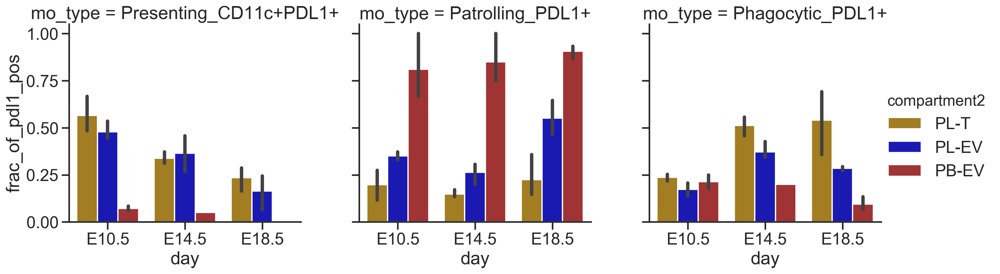

In [117]:
sns.set_style("ticks")
g = sns.catplot(x='day', y='frac_of_pdl1_pos', col_order = ['Presenting_CD11c+PDL1+', 'Patrolling_PDL1+','Phagocytic_PDL1+'],
                col='mo_type', data=  pdl1_clust[pdl1_clust['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

In [80]:
days = [('E10.5', 'E14.5'), ('E14.5', 'E18.5'), ('E18.5', 'E10.5')]
combos = [('PL-T', 'PL-EV'), ('PL-EV', 'PB-EV'), ('PB-EV', 'PL-T')]
t_test_pdl1_frac = pd.DataFrame(columns =['cluster', 'comp_only','day1', 'day2', 't-stat_day', 'p-value_day', 'Stat diff day', 'comp1', 'comp2', 'day_only', 't-stat_comp', 'p-value_comp', 'Stat diff comp'])

for cluster in ['0', '5','7']:   
    for comb in combos:
        for day in days: 
                day1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                day2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[1])]

                t_stat_day, p_day = ttest_ind(day1['frac_of_pdl1_pos'], day2['frac_of_pdl1_pos'])
                alpha = 0.05
                if p_day > alpha:
                    dist_day = 'no'
                else:
                    dist_day = 'yes'

                comp_1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                comp_2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[1])&
                                        (pdl1_clust['day']== day[0])]

                t_stat_comp, p_comp = ttest_ind(comp_1['frac_of_pdl1_pos'], comp_2['frac_of_pdl1_pos'])
                alpha = 0.05
                if p_comp > alpha:
                    dist_comp = 'no'
                else:
                    dist_comp = 'yes'


                data_df = pd.DataFrame(data ={'cluster': [cluster],
                                              'comp_only': [comb[0]],
                                              'day1':[day[0]],
                                              'day2':[day[1]],
                                              't-stat_day': [t_stat_day], 
                                              'p-value_day': [p_day], 
                                              'Stat diff day':[ dist_day],
                                              'comp1': [comb[0]],
                                              'comp2': [comb[1]],
                                              'day_only':[day[0]],
                                              't-stat_comp': [t_stat_comp], 
                                              'p-value_comp': [p_comp], 
                                              'Stat diff comp':[ dist_comp]})
                t_test_pdl1_frac = t_test_pdl1_frac.append(data_df)

In [81]:
t_test_pdl1_frac

,cluster,comp_only,day1,day2,t-stat_day,p-value_day,Stat diff day,comp1,comp2,day_only,t-stat_comp,p-value_comp,Stat diff comp
0,0,PL-T,E10.5,E14.5,2.425484,0.029397,yes,PL-T,PL-EV,E10.5,1.367552,0.201400,no
0,0,PL-T,E14.5,E18.5,1.680089,0.112356,no,PL-T,PL-EV,E14.5,-0.249149,0.806067,no
0,0,PL-T,E18.5,E10.5,-6.271649,0.000041,yes,PL-T,PL-EV,E18.5,-0.143266,0.888122,no
0,0,PL-EV,E10.5,E14.5,1.480339,0.160933,no,PL-EV,PB-EV,E10.5,2.559459,0.030714,yes
0,0,PL-EV,E14.5,E18.5,1.374566,0.188213,no,PL-EV,PB-EV,E14.5,0.957117,0.359071,no
0,0,PL-EV,E18.5,E10.5,-2.726116,0.018398,yes,PL-EV,PB-EV,E18.5,0.375300,0.716129,no
0,0,PB-EV,E10.5,E14.5,0.400098,0.702940,no,PB-EV,PL-T,E10.5,-3.240483,0.010151,yes
0,0,PB-EV,E14.5,E18.5,0.504778,0.640255,no,PB-EV,PL-T,E14.5,-0.812112,0.433951,no
0,0,PB-EV,E18.5,E10.5,-0.926762,0.389807,no,PB-EV,PL-T,E18.5,-0.467435,0.651299,no
0,5,PL-T,E10.5,E14.5,-0.239380,0.814544,no,PL-T,PL-EV,E10.5,-2.581458,0.027348,yes


In [82]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
pdl1_cluststats_csv = '20200928_maternalmo_pdl1_clust_counts_stats.csv'
pdl1_cluststats_filepath = os.path.join(subsample_path, pdl1_cluststats_csv) 
t_test_pdl1_frac.to_csv(pdl1_cluststats_filepath, index = False)

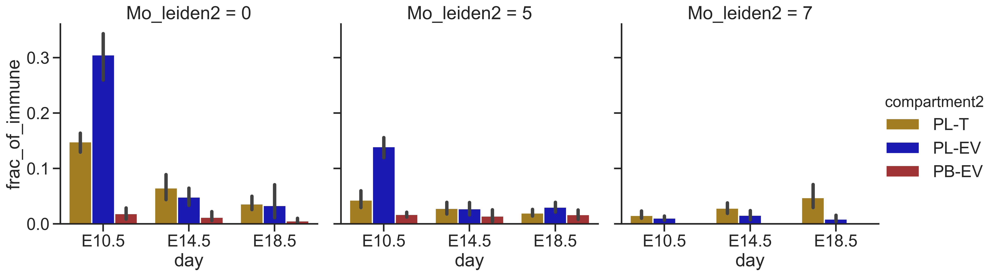

In [15]:
sns.set_style("ticks")
g = sns.catplot(x='day', y='frac_of_immune',
                col='Mo_leiden2', data= pdl1_clust[pdl1_clust['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

In [17]:
from scipy.stats import ttest_ind

In [18]:
days = [('E10.5', 'E14.5'), ('E14.5', 'E18.5'), ('E18.5', 'E10.5')]
combos = [('PL-T', 'PL-EV'), ('PL-EV', 'PB-EV'), ('PB-EV', 'PL-T')]
t_test_immune_frac = pd.DataFrame(columns =['cluster', 'comp_only','day1', 'day2', 't-stat_day', 'p-value_day', 'Stat diff day', 'comp1', 'comp2', 'day_only', 't-stat_comp', 'p-value_comp', 'Stat diff comp'])

for cluster in ['0', '5','7']:   
    for comb in combos:
        for day in days: 
                day1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                day2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[1])]

                t_stat_day, p_day = ttest_ind(day1['frac_of_immune'], day2['frac_of_immune'])
                alpha = 0.05
                if p_day > alpha:
                    dist_day = 'no'
                else:
                    dist_day = 'yes'

                comp_1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                comp_2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[1])&
                                        (pdl1_clust['day']== day[0])]

                t_stat_comp, p_comp = ttest_ind(comp_1['frac_of_immune'], comp_2['frac_of_immune'])
                alpha = 0.05
                if p_comp > alpha:
                    dist_comp = 'no'
                else:
                    dist_comp = 'yes'


                data_df = pd.DataFrame(data ={'cluster': [cluster],
                                              'comp_only': [comb[0]],
                                              'day1':[day[0]],
                                              'day2':[day[1]],
                                              't-stat_day': [t_stat_day], 
                                              'p-value_day': [p_day], 
                                              'Stat diff day':[ dist_day],
                                              'comp1': [comb[0]],
                                              'comp2': [comb[1]],
                                              'day_only':[day[0]],
                                              't-stat_comp': [t_stat_comp], 
                                              'p-value_comp': [p_comp], 
                                              'Stat diff comp':[ dist_comp]})
                t_test_immune_frac = t_test_immune_frac.append(data_df)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3367: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/numpy/core/_methods.py:132: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


In [85]:
day1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== '0') & 
                                        (pdl1_clust['compartment2']== 'PL-T')&
                                        (pdl1_clust['day']== 'E10.5')]

In [86]:
pdl1_clust[(pdl1_clust['Mo_leiden2']== '0') & 
                                        (pdl1_clust['compartment2']== 'PL-T')&
                                        (pdl1_clust['day']== 'E14.5')]

,Mo_leiden2,compartment2,organ,location,day,challenge,timePI,cage,id,test_status,counts,sample,sample_total,frac_of_comp_sample,full_sample_total,frac_of_immune,PDL1_status,pdl1_counts,frac_of_pdl1_pos
114,0,PL-T,PL_F,T,E14.5,sal,2hr,1136,1,test,23,1136_1_E14.5_sal_2hr_PL_F_T,125,0.184000,321.0,0.071651,pos,31.0,0.741935
115,0,PL-T,PL_F,T,E14.5,sal,2hr,8240,11,test,21,8240_11_E14.5_sal_2hr_PL_F_T,133,0.157895,354.0,0.059322,pos,30.0,0.700000
116,0,PL-T,PL_F,T,E14.5,sal,2hr,9581,10,test,6,9581_10_E14.5_sal_2hr_PL_F_T,50,0.120000,177.0,0.033898,pos,18.0,0.333333
117,0,PL-T,PL_F,T,E14.5,sal,2hr,9581,10,test,2,9581_10_E14.5_sal_2hr_PL_F_T,50,0.040000,177.0,0.011299,pos,18.0,0.111111
118,0,PL-T,PL_F,T,E14.5,sal,2hr,9581,8,test,7,9581_8_E14.5_sal_2hr_PL_F_T,29,0.241379,132.0,0.053030,pos,17.0,0.411765
119,0,PL-T,PL_F,T,E14.5,sal,2hr,9581,9,test,33,9581_9_E14.5_sal_2hr_PL_F_T,96,0.343750,209.0,0.157895,pos,51.0,0.647059
154,0,PL-T,PL_M,T,E14.5,sal,2hr,8240,11,test,32,8240_11_E14.5_sal_2hr_PL_M_T,103,0.310680,311.0,0.102894,pos,49.0,0.653061
155,0,PL-T,PL_M,T,E14.5,sal,2hr,9581,10,test,8,9581_10_E14.5_sal_2hr_PL_M_T,45,0.177778,174.0,0.045977,pos,19.0,0.421053
156,0,PL-T,PL_M,T,E14.5,sal,2hr,9581,8,test,14,9581_8_E14.5_sal_2hr_PL_M_T,54,0.259259,198.0,0.070707,pos,20.0,0.700000
157,0,PL-T,PL_M,T,E14.5,sal,2hr,9581,9,test,7,9581_9_E14.5_sal_2hr_PL_M_T,56,0.125000,163.0,0.042945,pos,22.0,0.318182


In [20]:
t_test_immune_frac

,cluster,comp_only,day1,day2,t-stat_day,p-value_day,Stat diff day,comp1,comp2,day_only,t-stat_comp,p-value_comp,Stat diff comp
0,0,PL-T,E10.5,E14.5,4.542092,4.605979e-04,yes,PL-T,PL-EV,E10.5,-6.224001,0.000098,yes
0,0,PL-T,E14.5,E18.5,1.830721,8.583120e-02,no,PL-T,PL-EV,E14.5,1.072263,0.297768,no
0,0,PL-T,E18.5,E10.5,-10.016608,3.517673e-07,yes,PL-T,PL-EV,E18.5,0.156201,0.878105,no
0,0,PL-EV,E10.5,E14.5,12.368634,6.336892e-09,yes,PL-EV,PB-EV,E10.5,10.851281,0.000002,yes
0,0,PL-EV,E14.5,E18.5,0.821600,4.233788e-01,no,PL-EV,PB-EV,E14.5,2.295419,0.042372,yes
0,0,PL-EV,E18.5,E10.5,-9.345872,7.401038e-07,yes,PL-EV,PB-EV,E18.5,0.904513,0.389294,no
0,0,PB-EV,E10.5,E14.5,0.774439,4.680808e-01,no,PB-EV,PL-T,E10.5,-11.101827,0.000001,yes
0,0,PB-EV,E14.5,E18.5,1.195603,2.978840e-01,no,PB-EV,PL-T,E14.5,-2.159151,0.053784,no
0,0,PB-EV,E18.5,E10.5,-1.668952,1.461684e-01,no,PB-EV,PL-T,E18.5,-2.704924,0.024198,yes
0,5,PL-T,E10.5,E14.5,1.516010,1.534499e-01,no,PL-T,PL-EV,E10.5,-7.102555,0.000033,yes


In [19]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
immune_cluststats_csv = '20200929_maternalmo_pdl1_ouof_immune_counts_stats.csv'
immune_cluststats_filepath = os.path.join(subsample_path, immune_cluststats_csv) 
t_test_immune_frac.to_csv(immune_cluststats_filepath, index = False)

# Supp Figure 3G

In [23]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '20200928_maternalmo_nopdl1clust_cell_type_counts_per_sample.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
clean_counts_full= pd.read_csv(counts_filepath)

In [56]:
clean_counts_full['PDL1_status'] = np.where(clean_counts_full['Mo_leiden2'].isin(['0', '4', '5', '7', '8']), 'pos', 'neg')
PDL1_counts_df = clean_counts_full.groupby(['PDL1_status', 'sample']).sum()
pdl1_dict = PDL1_counts_df.loc['pos', 'counts'].to_dict()
clean_counts_full.loc[:,'pdl1_counts'] = clean_counts_full.loc[:,'sample'].map(pdl1_dict)
pdl1_clust = clean_counts_full[clean_counts_full['Mo_leiden2'].isin(['0', '4', '5', '7', '8'])]
pdl1_clust['frac_of_pdl1_pos'] = pdl1_clust['counts']/clean_counts_full['pdl1_counts'] 

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [59]:
pdl1_clust['Mo_leiden2']= pdl1_clust['Mo_leiden2'].astype('str')

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [28]:
int_days = ['E10.5', 'E14.5', 'E18.5']

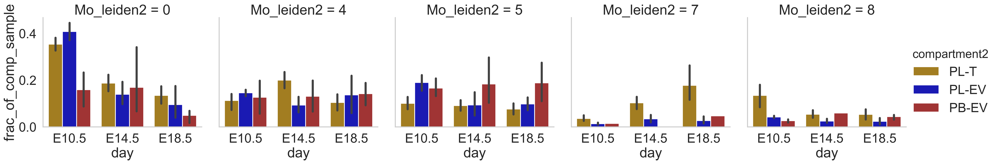

In [29]:
sns.set_context('talk', font_scale= 1.5)
g = sns.catplot(x='day', y='frac_of_comp_sample',
                col='Mo_leiden2', data= pdl1_clust[pdl1_clust['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

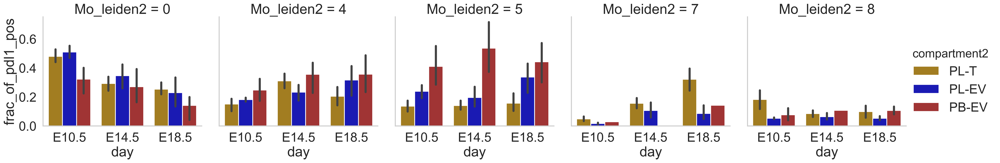

In [30]:
sns.set_context('talk', font_scale= 1.5)
g = sns.catplot(x='day', y='frac_of_pdl1_pos',
                col='Mo_leiden2', data=  pdl1_clust[pdl1_clust['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

In [60]:
days = [('E10.5', 'E14.5'), ('E14.5', 'E18.5'), ('E18.5', 'E10.5')]
combos = [('PL-T', 'PL-EV'), ('PL-EV', 'PB-EV'), ('PB-EV', 'PL-T')]
t_test_pdl1_frac = pd.DataFrame(columns =['cluster', 'comp_only','day1', 'day2', 't-stat_day', 'p-value_day', 'Stat diff day', 'comp1', 'comp2', 'day_only', 't-stat_comp', 'p-value_comp', 'Stat diff comp'])

for cluster in ['0', '4','5','7', '8']:   
    for comb in combos:
        for day in days: 
                day1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                day2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[1])]

                t_stat_day, p_day = ttest_ind(day1['frac_of_pdl1_pos'], day2['frac_of_pdl1_pos'])
                alpha = 0.05
                if p_day > alpha:
                    dist_day = 'no'
                else:
                    dist_day = 'yes'

                comp_1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                comp_2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[1])&
                                        (pdl1_clust['day']== day[0])]

                t_stat_comp, p_comp = ttest_ind(comp_1['frac_of_pdl1_pos'], comp_2['frac_of_pdl1_pos'])
                alpha = 0.05
                if p_comp > alpha:
                    dist_comp = 'no'
                else:
                    dist_comp = 'yes'


                data_df = pd.DataFrame(data ={'cluster': [cluster],
                                              'comp_only': [comb[0]],
                                              'day1':[day[0]],
                                              'day2':[day[1]],
                                              't-stat_day': [t_stat_day], 
                                              'p-value_day': [p_day], 
                                              'Stat diff day':[ dist_day],
                                              'comp1': [comb[0]],
                                              'comp2': [comb[1]],
                                              'day_only':[day[0]],
                                              't-stat_comp': [t_stat_comp], 
                                              'p-value_comp': [p_comp], 
                                              'Stat diff comp':[ dist_comp]})
                t_test_pdl1_frac = t_test_pdl1_frac.append(data_df)

In [61]:
t_test_pdl1_frac

,cluster,comp_only,day1,day2,t-stat_day,p-value_day,Stat diff day,comp1,comp2,day_only,t-stat_comp,p-value_comp,Stat diff comp
0,0,PL-T,E10.5,E14.5,4.103838,0.000507,yes,PL-T,PL-EV,E10.5,-0.875358,0.401915,no
0,0,PL-T,E14.5,E18.5,0.969763,0.342253,no,PL-T,PL-EV,E14.5,-1.113328,0.275755,no
0,0,PL-T,E18.5,E10.5,-6.510501,0.000029,yes,PL-T,PL-EV,E18.5,0.395305,0.698576,no
0,0,PL-EV,E10.5,E14.5,2.467790,0.026112,yes,PL-EV,PB-EV,E10.5,3.392448,0.007968,yes
0,0,PL-EV,E14.5,E18.5,1.621616,0.123284,no,PL-EV,PB-EV,E14.5,0.926070,0.370099,no
0,0,PL-EV,E18.5,E10.5,-4.106602,0.001455,yes,PL-EV,PB-EV,E18.5,0.891265,0.395989,no
0,0,PB-EV,E10.5,E14.5,0.603996,0.562578,no,PB-EV,PL-T,E10.5,-2.803567,0.020592,yes
0,0,PB-EV,E14.5,E18.5,1.338437,0.229239,no,PB-EV,PL-T,E14.5,-0.378149,0.709304,no
0,0,PB-EV,E18.5,E10.5,-2.236397,0.066677,no,PB-EV,PL-T,E18.5,-2.312069,0.046080,yes
0,4,PL-T,E10.5,E14.5,-3.477520,0.002376,yes,PL-T,PL-EV,E10.5,-1.193982,0.260039,no


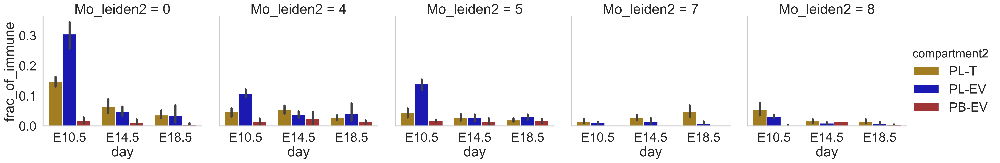

In [34]:
sns.set_context('talk', font_scale= 1.5)
g = sns.catplot(x='day', y='frac_of_immune',
                col='Mo_leiden2', data= pdl1_clust[pdl1_clust['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

In [62]:
days = [('E10.5', 'E14.5'), ('E14.5', 'E18.5'), ('E18.5', 'E10.5')]
combos = [('PL-T', 'PL-EV'), ('PL-EV', 'PB-EV'), ('PB-EV', 'PL-T')]
t_test_immune_frac = pd.DataFrame(columns =['cluster', 'comp_only','day1', 'day2', 't-stat_day', 'p-value_day', 'Stat diff day', 'comp1', 'comp2', 'day_only', 't-stat_comp', 'p-value_comp', 'Stat diff comp'])

for cluster in ['0', '4', '5','7', '8']:   
    for comb in combos:
        for day in days: 
                day1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                day2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[1])]

                t_stat_day, p_day = ttest_ind(day1['frac_of_immune'], day2['frac_of_immune'])
                alpha = 0.05
                if p_day > alpha:
                    dist_day = 'no'
                else:
                    dist_day = 'yes'

                comp_1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                comp_2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[1])&
                                        (pdl1_clust['day']== day[0])]

                t_stat_comp, p_comp = ttest_ind(comp_1['frac_of_pdl1_pos'], comp_2['frac_of_pdl1_pos'])
                alpha = 0.05
                if p_comp > alpha:
                    dist_comp = 'no'
                else:
                    dist_comp = 'yes'


                data_df = pd.DataFrame(data ={'cluster': [cluster],
                                              'comp_only': [comb[0]],
                                              'day1':[day[0]],
                                              'day2':[day[1]],
                                              't-stat_day': [t_stat_day], 
                                              'p-value_day': [p_day], 
                                              'Stat diff day':[ dist_day],
                                              'comp1': [comb[0]],
                                              'comp2': [comb[1]],
                                              'day_only':[day[0]],
                                              't-stat_comp': [t_stat_comp], 
                                              'p-value_comp': [p_comp], 
                                              'Stat diff comp':[ dist_comp]})
                t_test_immune_frac = t_test_immune_frac.append(data_df)

In [63]:
t_test_immune_frac

,cluster,comp_only,day1,day2,t-stat_day,p-value_day,Stat diff day,comp1,comp2,day_only,t-stat_comp,p-value_comp,Stat diff comp
0,0,PL-T,E10.5,E14.5,NaN,NaN,yes,PL-T,PL-EV,E10.5,-0.875358,0.401915,no
0,0,PL-T,E14.5,E18.5,NaN,NaN,yes,PL-T,PL-EV,E14.5,-1.113328,0.275755,no
0,0,PL-T,E18.5,E10.5,-10.016608,3.517673e-07,yes,PL-T,PL-EV,E18.5,0.395305,0.698576,no
0,0,PL-EV,E10.5,E14.5,NaN,NaN,yes,PL-EV,PB-EV,E10.5,3.392448,0.007968,yes
0,0,PL-EV,E14.5,E18.5,NaN,NaN,yes,PL-EV,PB-EV,E14.5,0.926070,0.370099,no
0,0,PL-EV,E18.5,E10.5,-9.345872,7.401038e-07,yes,PL-EV,PB-EV,E18.5,0.891265,0.395989,no
0,0,PB-EV,E10.5,E14.5,NaN,NaN,yes,PB-EV,PL-T,E10.5,-2.803567,0.020592,yes
0,0,PB-EV,E14.5,E18.5,NaN,NaN,yes,PB-EV,PL-T,E14.5,-0.378149,0.709304,no
0,0,PB-EV,E18.5,E10.5,-1.668952,1.461684e-01,no,PB-EV,PL-T,E18.5,-2.312069,0.046080,yes
0,4,PL-T,E10.5,E14.5,NaN,NaN,yes,PL-T,PL-EV,E10.5,-1.193982,0.260039,no
